# Analysis of results extracted with Boosting + Complexity Measures

In this notebook we are going to compare the results (error rate and exponential loss) obtained with all the different options we have tested:
* Classic AdaBoost: this implies that weights are initializated with 1/n
* Classic AdaBoost with initial weights modified by means of complexity measures. The options are: init_easy and init_hard. We have obtained the results with basic weights and multiplying by 2 to give even more weight to easy and even more weight to hard.
* We have also modified Adaboost in the calculation of the error by multiplying by a factor according to a complexity measure: 

$error_m = \dfrac{ \sum_{i=1}^n (w_i * (1 + \lambda*CM\_values_{i}) * disagree)}{\sum_{i=1}^n (w_i * (1 + \lambda*CM\_values_{i}))}  $
We try it giving more weight to easy (error_w_easy) and to hard (error_w_hard) and with $\lambda = 0.025, 0.05$

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import glob
import math
from All_measures import all_measures


os.chdir("..")
root_path = os.getcwd()

In [2]:
path_csv = os.path.join(root_path, 'Results_Boosting_allmethods')
os.chdir(path_csv)


In [3]:
#colour_palette_personalized = ["#FFD700", "#00CED1", "#FF1493","#F1F1F1"]
colour_palette_personalized = {
    "classic": "#FFD700",   # yellow
    "init_easy": "#C7F7FF", # blue
    "init_easy_x2": "#00CED1", # blue
    "init_hard": "#FFB3DA",    # magenta
    "init_hard_x2": "#FF1493",    # magenta
    "error_w_easy_0.025": "#91E2B1" ,    # green
    "error_w_easy_0.05": "#03682B" ,    # green
    "error_w_hard_0.025": "#E0B3FF" ,    # violet
    "error_w_hard_0.05": "#9701FF" ,    # violet
    # "Classic": "#FFD700",   # yellow
    # "Easy": "#00CED1", # blue
    # "Hard": "#FF1493",    # magenta
}

# Analysis aggregating results for all datasets

We perform this analysis for all the datasets now. We read all the csv and we aggregate the results to obtain a general overview.

In [4]:
specific_path = os.path.join(path_csv, '*Aggregated*.csv')
selected_files = glob.glob(specific_path)
all_datasets = pd.concat([pd.read_csv(f) for f in selected_files], ignore_index=True)

In [5]:
all_datasets.reset_index()
all_datasets.shape

(963600, 11)

We aggregate all the results by calculating mean, median and standard deviation of exp_loss, misc_rate_train and misc_rate_test

In [6]:
all_adaboost = all_datasets.groupby(['n_ensemble', 'method_weights', 'compl_measure']).agg(
    exp_loss_avg_train_mean=('exp_loss_avg_train_mean', 'mean'),
    exp_loss_avg_train_median=('exp_loss_avg_train_mean', 'median'),
    exp_loss_avg_train_std=('exp_loss_avg_train_mean', 'std'),
    misc_rate_train_mean_mean=('misc_rate_train_mean', 'mean'),
    misc_rate_train_mean_median=('misc_rate_train_mean', 'median'),
    misc_rate_train_mean_std=('misc_rate_train_mean', 'std'),
    misc_rate_test_mean_mean=('misc_rate_test_mean', 'mean'),
    misc_rate_test_mean_median=('misc_rate_test_mean', 'median'),
    misc_rate_test_mean_std=('misc_rate_test_mean', 'std')
).reset_index()

In [7]:
all_adaboost.head()

,n_ensemble,method_weights,compl_measure,exp_loss_avg_train_mean,exp_loss_avg_train_median,exp_loss_avg_train_std,misc_rate_train_mean_mean,misc_rate_train_mean_median,misc_rate_train_mean_std,misc_rate_test_mean_mean,misc_rate_test_mean_median,misc_rate_test_mean_std
0,1,classic,none,0.988217,1.006722,0.272742,0.263928,0.271802,0.11604,0.279094,0.286433,0.120019
1,1,error_w_easy_0.025,CLD,0.988217,1.006722,0.272742,0.263928,0.271802,0.11604,0.279094,0.286433,0.120019
2,1,error_w_easy_0.025,DCP,0.988217,1.006722,0.272742,0.263928,0.271802,0.11604,0.279094,0.286433,0.120019
3,1,error_w_easy_0.025,F1,0.988217,1.006722,0.272742,0.263928,0.271802,0.11604,0.279094,0.286433,0.120019
4,1,error_w_easy_0.025,Hostility,0.988217,1.006722,0.272742,0.263928,0.271802,0.11604,0.279094,0.286433,0.120019


In [152]:
#all_adaboost.to_csv('All_results_AdaBoost_Averaged_per_Dataset.csv', index=False)

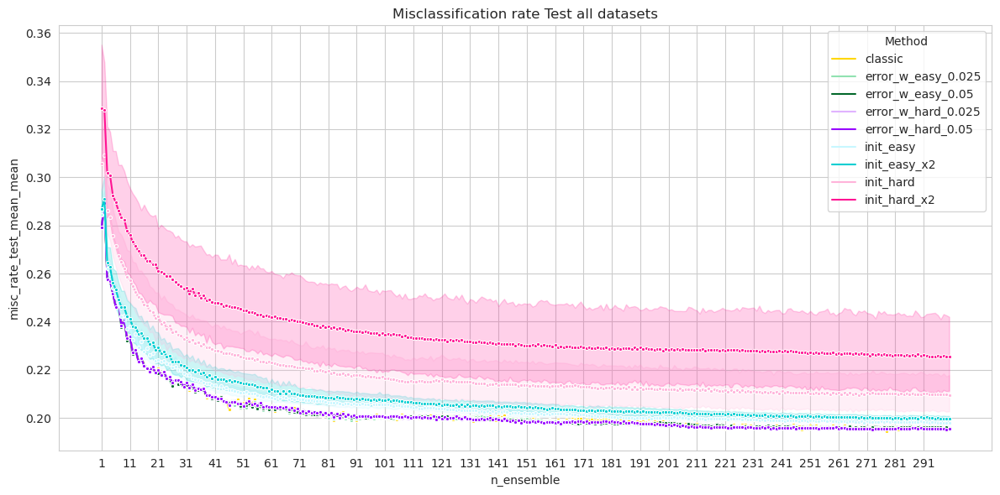

In [8]:
plt.figure(figsize=(12, 6))

sns.lineplot(data=all_adaboost, x='n_ensemble', y='misc_rate_test_mean_mean', hue='method_weights', errorbar=('ci', 95), marker='.',
             palette=colour_palette_personalized) #  errorbar=(None)

plt.title('Misclassification rate Test all datasets')
plt.xlabel('n_ensemble')
plt.ylabel('misc_rate_test_mean_mean')
plt.legend(title='Method')
plt.xticks(ticks=range(1, 301, 10)) 
plt.grid(True)
plt.tight_layout()
plt.show()

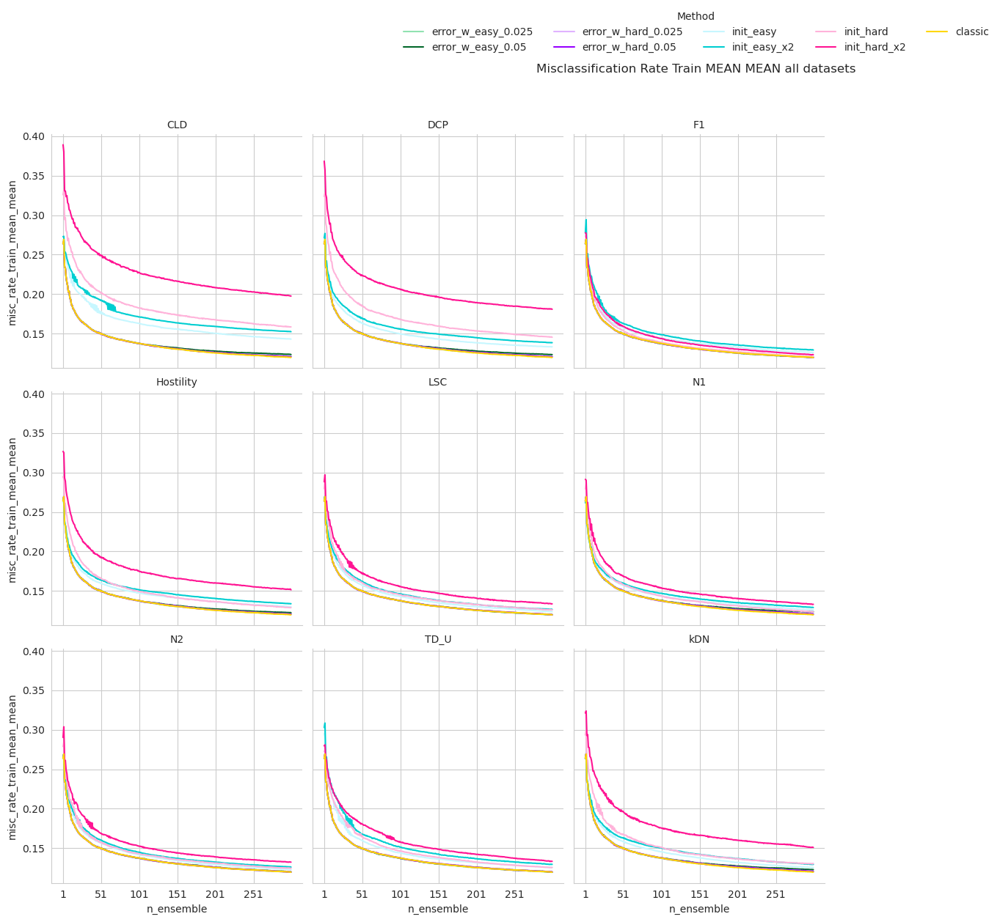

In [9]:
df_complete_all = []

for compl in all_adaboost[all_adaboost['method_weights'] != "classic"]['compl_measure'].unique():
    df_subset = all_adaboost[all_adaboost['compl_measure'] == compl]

    df_complete_all.append(df_subset)

    classic_data = all_adaboost[(all_adaboost['method_weights'] == "classic") & (all_adaboost['compl_measure'] == "none")].copy()
    classic_data['compl_measure'] = compl
    df_complete_all.append(classic_data)

df_complete_all = pd.concat(df_complete_all)

g = sns.FacetGrid(df_complete_all, col="compl_measure", hue="method_weights", col_wrap=3, height=4, palette=colour_palette_personalized)

g.map(sns.lineplot, 'n_ensemble', 'misc_rate_train_mean_mean')

g.set_titles("{col_name}")
g.set_axis_labels("n_ensemble", "misc_rate_train_mean_mean")
g.add_legend(title="Method", loc='upper center', bbox_to_anchor=(0.5, 1.05), ncol=5, frameon=False)

for ax in g.axes.flat:
    ax.set_xticks(range(1, 301, 50))
    ax.grid(True)

plt.subplots_adjust(top=0.9)
g.fig.suptitle('Misclassification Rate Train MEAN MEAN all datasets')
plt.show()

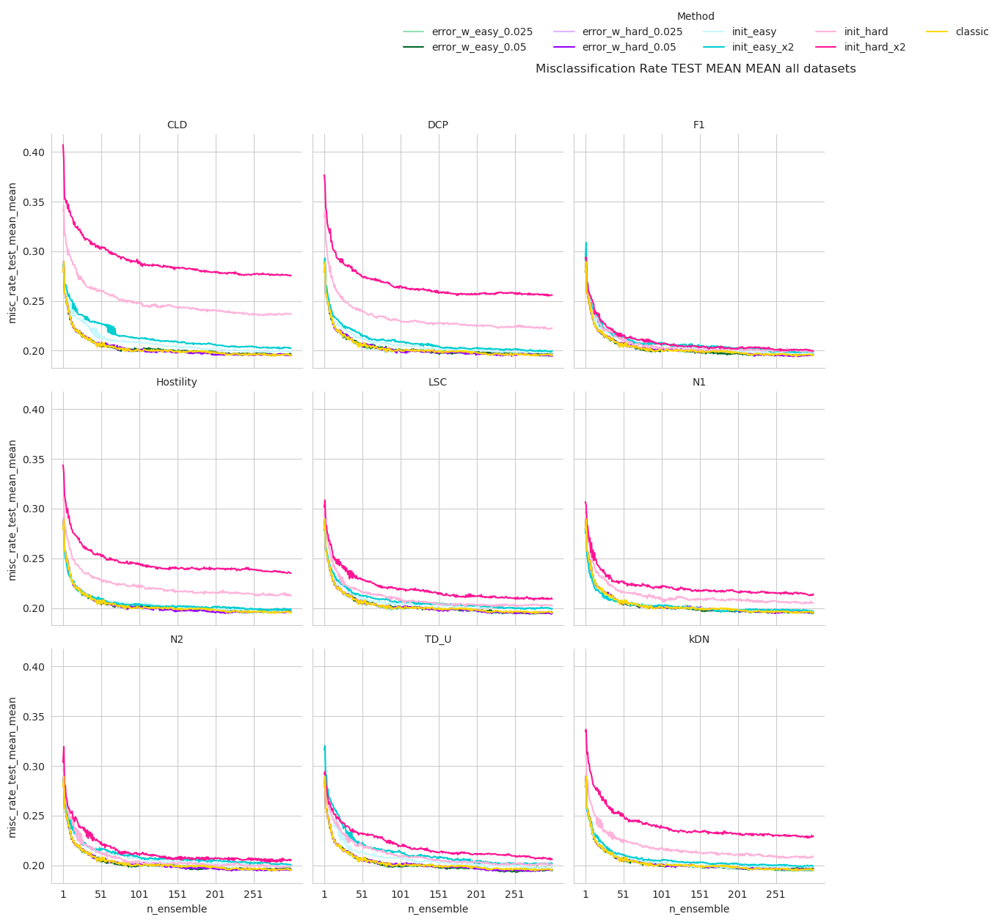

In [10]:
g = sns.FacetGrid(df_complete_all, col="compl_measure", hue="method_weights", col_wrap=3, height=4, palette=colour_palette_personalized)

g.map(sns.lineplot, 'n_ensemble', 'misc_rate_test_mean_mean')

g.set_titles("{col_name}")
g.set_axis_labels("n_ensemble", "misc_rate_test_mean_mean")
g.add_legend(title="Method", loc='upper center', bbox_to_anchor=(0.5, 1.05), ncol=5, frameon=False)

for ax in g.axes.flat:
    ax.set_xticks(range(1, 301, 50))
    ax.grid(True)

plt.subplots_adjust(top=0.9)
g.fig.suptitle('Misclassification Rate TEST MEAN MEAN all datasets')
plt.show()

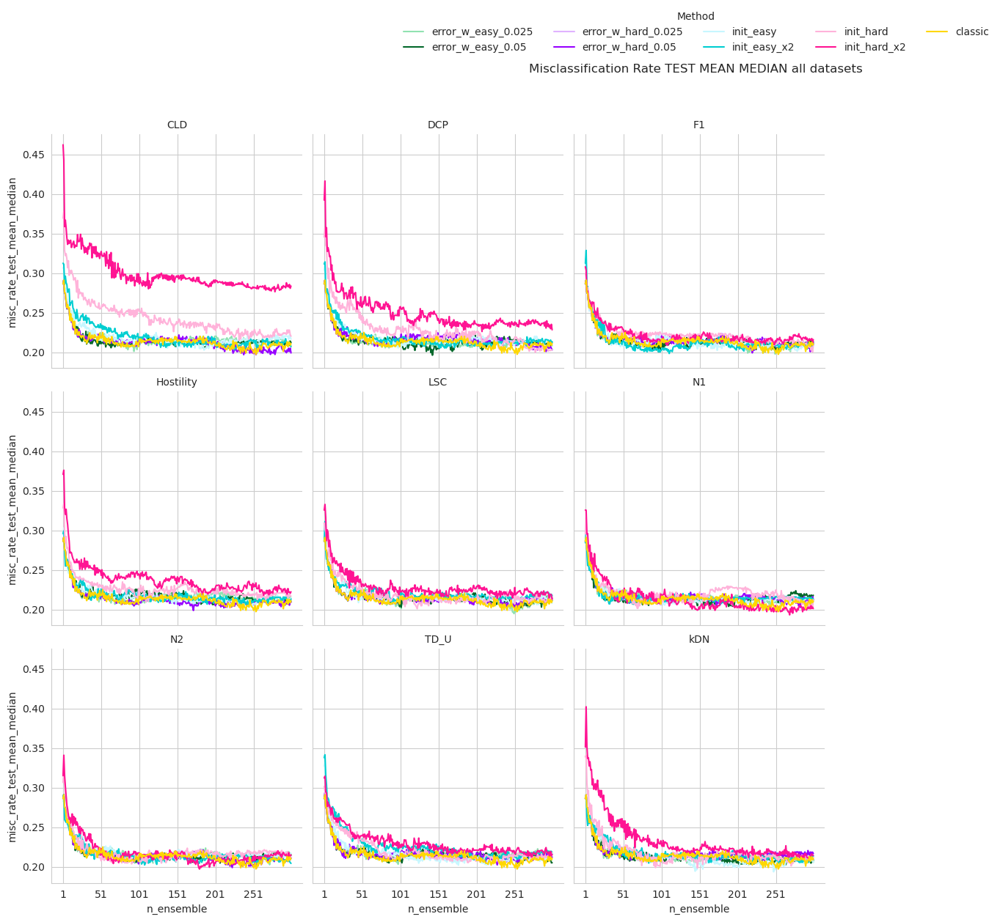

In [11]:
g = sns.FacetGrid(df_complete_all, col="compl_measure", hue="method_weights", col_wrap=3, height=4, palette=colour_palette_personalized)

g.map(sns.lineplot, 'n_ensemble', 'misc_rate_test_mean_median')

g.set_titles("{col_name}")
g.set_axis_labels("n_ensemble", "misc_rate_test_mean_median")
g.add_legend(title="Method", loc='upper center', bbox_to_anchor=(0.5, 1.05), ncol=5, frameon=False)

for ax in g.axes.flat:
    ax.set_xticks(range(1, 301, 50))
    ax.grid(True)

plt.subplots_adjust(top=0.9)
g.fig.suptitle('Misclassification Rate TEST MEAN MEDIAN all datasets')
plt.show()

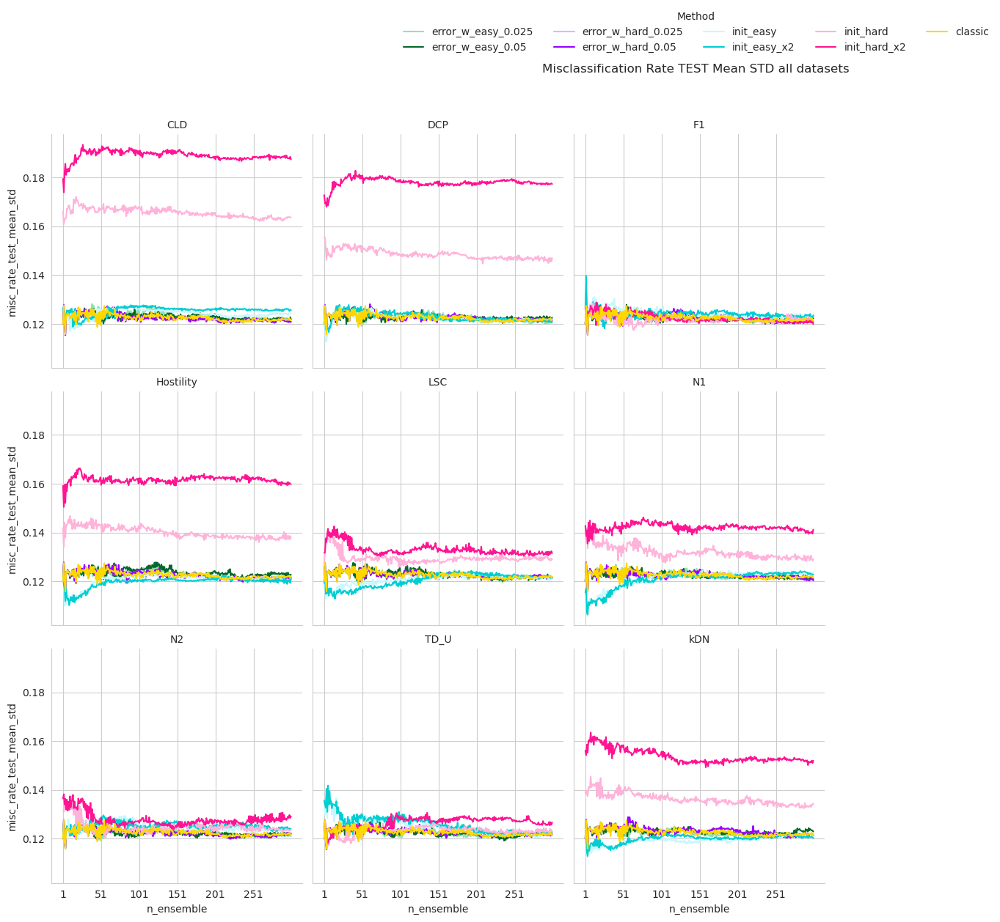

In [15]:
g = sns.FacetGrid(df_complete_all, col="compl_measure", hue="method_weights", col_wrap=3, height=4, palette=colour_palette_personalized)

g.map(sns.lineplot, 'n_ensemble', 'misc_rate_test_mean_std')

g.set_titles("{col_name}")
g.set_axis_labels("n_ensemble", "misc_rate_test_mean_std")
g.add_legend(title="Method", loc='upper center', bbox_to_anchor=(0.5, 1.05), ncol=5, frameon=False)

for ax in g.axes.flat:
    ax.set_xticks(range(1, 301, 50))
    ax.grid(True)

plt.subplots_adjust(top=0.9)
g.fig.suptitle('Misclassification Rate TEST Mean STD all datasets')
plt.show()

In [12]:
# Encontrar el menor valor de misc_rate_test_mean para cada métod
resultados = []

# Agrupar por dataset y method_weights
for dataset in all_datasets['dataset'].unique():
    subset_dataset = all_datasets[all_datasets['dataset'] == dataset]
    
    for method in subset_dataset['method_weights'].unique():
        subset_method = subset_dataset[subset_dataset['method_weights'] == method]
        min_misc_rate = subset_method['misc_rate_test_mean'].min()
        
        # Obtener el n_ensemble correspondiente
        n_ensemble_at_min = subset_method.loc[subset_method['misc_rate_test_mean'] == min_misc_rate, 'n_ensemble'].values[0]
        
        resultados.append({
            'dataset': dataset,
            'method_weights': method,
            'min_misc_rate_test_mean': min_misc_rate,
            'n_ensemble': n_ensemble_at_min
        })

# Convertir a DataFrame para una mejor visualización
resultados_df = pd.DataFrame(resultados)

# Mostrar los resultados
resultados_df

,dataset,method_weights,min_misc_rate_test_mean,n_ensemble
0,ring,classic,0.039730,300
1,ring,error_w_easy_0.05,0.038243,298
2,ring,error_w_hard_0.05,0.038919,286
3,ring,error_w_easy_0.025,0.037973,299
4,ring,error_w_hard_0.025,0.038919,286
...,...,...,...,...
391,diabetic_retinopathy,error_w_hard_0.05,0.303253,270
392,diabetic_retinopathy,init_easy,0.297189,219
393,diabetic_retinopathy,init_hard,0.308396,282
394,diabetic_retinopathy,init_easy_x2,0.298021,242


Aquí tengo que estudiar con detalle quién consigue el mínimo y de qué manera porque en algunos casos nosotros lo conseguimos mucho antes y eso es muy interesante. Esto pasa cuando se analiza todo de forma global, al ir estudiando (más abajo) de forma individual por cada medida de complejidad vemos que nuestro máximo de mejores mínimos es del 40% .
 Por otro lado, voy a hacer los gráficos estos pero diferenciando por complejidad del dataset.
También hacemos tabla poniendo cuándo consigue lo mejor cada uno para cada dataset, en qué momento y añadir mediana y std
Para hacer una comparativa para distintos valores de n_ensemble, hacemos tipo WTL, como hicimos en Bagging
Más adelante ya platearemos test de significatividad


In [13]:
list_methods = all_datasets.method_weights.unique()

In [14]:

# Paso 1: Tabla de mínimos
min_results = []
datasets = all_datasets['dataset'].unique()

for dataset in datasets:
    dataset_info = {'Dataset': dataset}
    # Obtener el mínimo para cada métod
    for method in list_methods:
        subset_method = all_datasets[(all_datasets['dataset'] == dataset) & 
                                     (all_datasets['method_weights'] == method)]
        
        if not subset_method.empty:
            min_misc_rate = subset_method['misc_rate_test_mean'].min()
            n_ensemble_at_min = subset_method.loc[subset_method['misc_rate_test_mean'] == min_misc_rate, 'n_ensemble'].values[0]
            
            # Verificar el umbral para init_easy e init_hard en relación con el mínimo de classic
            if method == 'classic':
                min_classic_misc_rate = min_misc_rate
            else:
                threshold_n_ensemble = subset_method.loc[
                    subset_method['misc_rate_test_mean'] <= min_classic_misc_rate, 'n_ensemble'
                ].min() if not subset_method.loc[subset_method['misc_rate_test_mean'] <= min_classic_misc_rate].empty else None
            
                dataset_info[f'{method}_n_ensemble_below_classic_min'] = threshold_n_ensemble

            dataset_info.update({
                f'{method}_min_misc_rate_test_mean': min_misc_rate,
                f'{method}_n_ensemble_min': n_ensemble_at_min
            })
    
    min_results.append(dataset_info)

# Convertir a DataFrame
min_results_df = pd.DataFrame(min_results)




In [15]:
min_results_df

,Dataset,classic_min_misc_rate_test_mean,classic_n_ensemble_min,error_w_easy_0.05_n_ensemble_below_classic_min,error_w_easy_0.05_min_misc_rate_test_mean,error_w_easy_0.05_n_ensemble_min,error_w_hard_0.05_n_ensemble_below_classic_min,error_w_hard_0.05_min_misc_rate_test_mean,error_w_hard_0.05_n_ensemble_min,error_w_easy_0.025_n_ensemble_below_classic_min,...,init_easy_n_ensemble_min,init_hard_n_ensemble_below_classic_min,init_hard_min_misc_rate_test_mean,init_hard_n_ensemble_min,init_easy_x2_n_ensemble_below_classic_min,init_easy_x2_min_misc_rate_test_mean,init_easy_x2_n_ensemble_min,init_hard_x2_n_ensemble_below_classic_min,init_hard_x2_min_misc_rate_test_mean,init_hard_x2_n_ensemble_min
0,ring,0.039730,300,283.0,0.038243,298,285.0,0.038919,286,277.0,...,297,247.0,0.035405,298,NaN,0.042162,281,196.0,0.035270,294
1,vertebral_column,0.145161,57,46.0,0.138710,192,41.0,0.141935,59,55.0,...,26,12.0,0.141935,65,NaN,0.148387,26,30.0,0.141935,199
2,teaching_assistant_MH,0.270000,244,193.0,0.241818,234,203.0,0.250000,298,202.0,...,285,233.0,0.252727,268,146.0,0.260000,166,263.0,0.270000,263
3,saheart,0.270490,9,9.0,0.270398,36,9.0,0.270490,9,9.0,...,13,NaN,0.285523,4,6.0,0.253191,17,NaN,0.283441,14
4,bodyfat,0.004000,1,1.0,0.004000,1,1.0,0.004000,1,1.0,...,1,1.0,0.004000,1,1.0,0.004000,1,1.0,0.004000,1
5,steel-plates-fault,0.000000,83,83.0,0.000000,83,81.0,0.000000,83,83.0,...,93,45.0,0.000000,148,60.0,0.000000,120,45.0,0.000000,194
6,titanic,0.209313,18,13.0,0.208538,18,9.0,0.207780,11,13.0,...,32,116.0,0.208538,120,4.0,0.199366,65,14.0,0.203188,31
7,liver-disorders,0.260000,91,13.0,0.246667,138,70.0,0.232857,121,38.0,...,8,3.0,0.233333,14,5.0,0.240476,10,3.0,0.213333,10
8,sonar,0.120476,71,31.0,0.106429,93,84.0,0.105952,246,71.0,...,207,105.0,0.100714,183,204.0,0.100714,298,88.0,0.105476,147
9,credit-g,0.232000,72,NaN,0.232000,73,NaN,0.233000,73,73.0,...,195,NaN,0.244000,146,45.0,0.221000,60,NaN,0.249000,118


In [16]:
min_results_df.columns

Index(['Dataset', 'classic_min_misc_rate_test_mean', 'classic_n_ensemble_min',
       'error_w_easy_0.05_n_ensemble_below_classic_min',
       'error_w_easy_0.05_min_misc_rate_test_mean',
       'error_w_easy_0.05_n_ensemble_min',
       'error_w_hard_0.05_n_ensemble_below_classic_min',
       'error_w_hard_0.05_min_misc_rate_test_mean',
       'error_w_hard_0.05_n_ensemble_min',
       'error_w_easy_0.025_n_ensemble_below_classic_min',
       'error_w_easy_0.025_min_misc_rate_test_mean',
       'error_w_easy_0.025_n_ensemble_min',
       'error_w_hard_0.025_n_ensemble_below_classic_min',
       'error_w_hard_0.025_min_misc_rate_test_mean',
       'error_w_hard_0.025_n_ensemble_min',
       'init_easy_n_ensemble_below_classic_min',
       'init_easy_min_misc_rate_test_mean', 'init_easy_n_ensemble_min',
       'init_hard_n_ensemble_below_classic_min',
       'init_hard_min_misc_rate_test_mean', 'init_hard_n_ensemble_min',
       'init_easy_x2_n_ensemble_below_classic_min',
       'init_

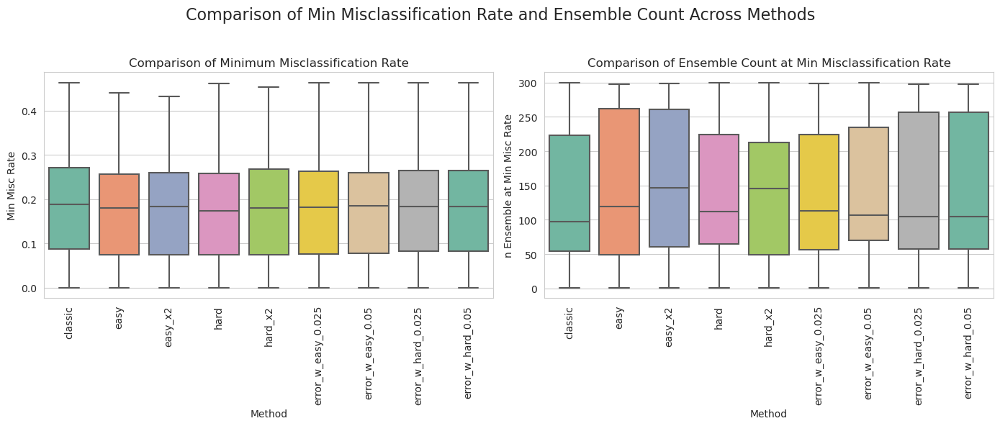

In [17]:
# Convertir los datos a formato largo para los boxplots
# Primero para los valores de misclassification rate
misc_rate_long = min_results_df.melt(
    id_vars='Dataset',
    value_vars=['classic_min_misc_rate_test_mean',
                'init_easy_min_misc_rate_test_mean',
                'init_easy_x2_min_misc_rate_test_mean',
                'init_hard_min_misc_rate_test_mean',
                'init_hard_x2_min_misc_rate_test_mean',
                'error_w_easy_0.025_min_misc_rate_test_mean',
                'error_w_easy_0.05_min_misc_rate_test_mean',
                'error_w_hard_0.025_min_misc_rate_test_mean',
                'error_w_hard_0.05_min_misc_rate_test_mean'],
    var_name='Method',
    value_name='Min Misc Rate'
)
# Cambiar nombres para ser más claros en el gráfico
misc_rate_long['Method'] = misc_rate_long['Method'].str.replace('_min_misc_rate_test_mean', '').str.replace('init_', '')

# Luego para los valores de n_ensemble en el mínimo misclassification rate
n_ensemble_long = min_results_df.melt(
    id_vars='Dataset',
    value_vars=['classic_n_ensemble_min',
                'init_easy_n_ensemble_min',
                'init_easy_x2_n_ensemble_min',
                'init_hard_n_ensemble_min',
                'init_hard_x2_n_ensemble_min',
                'error_w_easy_0.025_n_ensemble_min',
                'error_w_easy_0.05_n_ensemble_min',
                'error_w_hard_0.025_n_ensemble_min',
                'error_w_hard_0.05_n_ensemble_min'],
    var_name='Method',
    value_name='n Ensemble at Min Misc Rate'
)
n_ensemble_long['Method'] = n_ensemble_long['Method'].str.replace('_n_ensemble_min', '').str.replace('init_', '')

# Crear gráficos side-by-side
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

# Boxplot para Min Misc Rate
sns.boxplot(data=misc_rate_long, x='Method', y='Min Misc Rate', ax=axes[0], palette="Set2")
axes[0].set_title('Comparison of Minimum Misclassification Rate')
axes[0].set_xlabel('Method')
axes[0].set_ylabel('Min Misc Rate')
axes[0].tick_params(axis='x', rotation=90)

# Boxplot para n Ensemble at Min Misc Rate
sns.boxplot(data=n_ensemble_long, x='Method', y='n Ensemble at Min Misc Rate', ax=axes[1], palette="Set2")
axes[1].set_title('Comparison of Ensemble Count at Min Misclassification Rate')
axes[1].set_xlabel('Method')
axes[1].set_ylabel('n Ensemble at Min Misc Rate')
axes[1].tick_params(axis='x', rotation=90)

# Ajuste final del layout y título general
plt.suptitle('Comparison of Min Misclassification Rate and Ensemble Count Across Methods', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Ajuste para el título global
plt.show()

In [39]:
# Crear columnas con los valores mínimos de misc_rate para cada métod
classic_min = min_results_df['classic_min_misc_rate_test_mean']
easy_min = min_results_df['init_easy_min_misc_rate_test_mean']
easy_x2_min = min_results_df['init_easy_x2_min_misc_rate_test_mean']
hard_min = min_results_df['init_hard_min_misc_rate_test_mean']
hard_x2_min = min_results_df['init_hard_x2_min_misc_rate_test_mean']

error_w_easy_025_min = min_results_df['error_w_easy_0.025_min_misc_rate_test_mean']
error_w_easy_05_min = min_results_df['error_w_easy_0.05_min_misc_rate_test_mean']
error_w_hard_025_min = min_results_df['error_w_hard_0.025_min_misc_rate_test_mean']
error_w_hard_05_min = min_results_df['error_w_hard_0.05_min_misc_rate_test_mean']

# Calcular cuántas veces cada métod obtiene un mínimo menor que classic
easy_wins_over_classic = (easy_min < classic_min).sum()
easy_x2_wins_over_classic = (easy_x2_min < classic_min).sum()
hard_wins_over_classic = (hard_min < classic_min).sum()
hard_x2_wins_over_classic = (hard_x2_min < classic_min).sum()
error_w_easy_025_over_classic = (error_w_easy_025_min < classic_min).sum()
error_w_easy_05_wins_over_classic = (error_w_easy_05_min < classic_min).sum()
error_w_hard_025_wins_over_classic = (error_w_hard_025_min < classic_min).sum()
error_w_hard_05_wins_over_classic = (error_w_hard_05_min < classic_min).sum()

# Crear un DataFrame para mostrar los resultados
comparison_results = pd.DataFrame({
    'Method': ['init_easy','init_easy_x2', 'init_hard', 'init_hard_x2',
               'error_w_easy_0.025','error_w_easy_0.05',
               'error_w_hard_0.025','error_w_hard_0.05'],
    'Wins over classic': [easy_wins_over_classic,easy_x2_wins_over_classic,
                          hard_wins_over_classic,hard_x2_wins_over_classic,
                          error_w_easy_025_over_classic,error_w_easy_05_wins_over_classic,
                          error_w_hard_025_wins_over_classic,error_w_hard_05_wins_over_classic]
})

print(comparison_results)
# This comparison is not really fair because we are comparing the min of all complexity measures with the min of adaboost



               Method  Wins over classic
0           init_easy                 36
1        init_easy_x2                 31
2           init_hard                 35
3        init_hard_x2                 29
4  error_w_easy_0.025                 33
5   error_w_easy_0.05                 36
6  error_w_hard_0.025                 29
7   error_w_hard_0.05                 29


In [18]:
list_methods = all_datasets.method_weights.unique()
def min_misc_rate_CM(CM,all_datasets,list_methods):
    min_results = []
    datasets = all_datasets['dataset'].unique()

    for dataset in datasets:
        dataset_info = {'Dataset': dataset}
        # Obtener el mínimo para cada métod
        for method in list_methods:
            if (method == 'classic'):
                CM_value = 'none'
            else:
                CM_value = CM
            subset_method = all_datasets[(all_datasets['dataset'] == dataset) &
                                         (all_datasets['method_weights'] == method) &
                                         (all_datasets['compl_measure'] == CM_value)]
            min_misc_rate = subset_method['misc_rate_test_mean'].min()
            n_ensemble_at_min = subset_method.loc[subset_method['misc_rate_test_mean'] == min_misc_rate, 'n_ensemble'].values[0]

            dataset_info.update({
                f'{method}_min_misc_rate_test_mean': min_misc_rate,
                f'{method}_n_ensemble_min': n_ensemble_at_min
            })

        min_results.append(dataset_info)

    # Convertir a DataFrame
    min_results_df_CM = pd.DataFrame(min_results)

    # Crear columnas con los valores mínimos de misc_rate para cada métod
    classic_min = min_results_df_CM['classic_min_misc_rate_test_mean']
    easy_min = min_results_df_CM['init_easy_min_misc_rate_test_mean']
    easy_x2_min = min_results_df_CM['init_easy_x2_min_misc_rate_test_mean']
    hard_min = min_results_df_CM['init_hard_min_misc_rate_test_mean']
    hard_x2_min = min_results_df_CM['init_hard_x2_min_misc_rate_test_mean']
    error_w_easy_025_min = min_results_df_CM['error_w_easy_0.025_min_misc_rate_test_mean']
    error_w_easy_05_min = min_results_df_CM['error_w_easy_0.05_min_misc_rate_test_mean']
    error_w_hard_025_min = min_results_df_CM['error_w_hard_0.025_min_misc_rate_test_mean']
    error_w_hard_05_min = min_results_df_CM['error_w_hard_0.05_min_misc_rate_test_mean']

    # Calcular cuántas veces cada métod obtiene un mínimo menor que classic
    easy_wins_over_classic = (easy_min < classic_min).sum()
    easy_x2_wins_over_classic = (easy_x2_min < classic_min).sum()
    hard_wins_over_classic = (hard_min < classic_min).sum()
    hard_x2_wins_over_classic = (hard_x2_min < classic_min).sum()
    error_w_easy_025_over_classic = (error_w_easy_025_min < classic_min).sum()
    error_w_easy_05_wins_over_classic = (error_w_easy_05_min < classic_min).sum()
    error_w_hard_025_wins_over_classic = (error_w_hard_025_min < classic_min).sum()
    error_w_hard_05_wins_over_classic = (error_w_hard_05_min < classic_min).sum()

    # Crear un DataFrame para mostrar los resultados
    comparison_results_CM = pd.DataFrame({
        'Method': ['init_easy_'+CM, 'init_easy_x2_'+CM,
                   'init_hard_'+CM,'init_hard_x2_'+CM,
                   'error_w_easy_025_'+CM, 'error_w_easy_05_'+CM,
                   'error_w_hard_025_'+CM, 'error_w_hard_05_'+CM],
        'Wins over classic': [easy_wins_over_classic, easy_x2_wins_over_classic,
                              hard_wins_over_classic,hard_x2_wins_over_classic,
                              error_w_easy_025_over_classic,error_w_easy_05_wins_over_classic,
                              error_w_hard_025_wins_over_classic,error_w_hard_05_wins_over_classic]
    })

    return min_results_df_CM, comparison_results_CM


In [19]:
CM = 'Hostility'
min_results_df_Host, comparison_results_Host = min_misc_rate_CM(CM,all_datasets,list_methods)
CM = 'kDN'
min_results_df_kdn, comparison_results_kdn = min_misc_rate_CM(CM,all_datasets,list_methods)
CM = 'N1'
min_results_df_n1, comparison_results_n1 = min_misc_rate_CM(CM,all_datasets,list_methods)
CM = 'N2'
min_results_df_n2, comparison_results_n2 = min_misc_rate_CM(CM,all_datasets,list_methods)
CM = 'LSC'
min_results_df_LSC, comparison_results_LSC = min_misc_rate_CM(CM,all_datasets,list_methods)
CM = 'DCP'
min_results_df_DCP, comparison_results_DCP = min_misc_rate_CM(CM,all_datasets,list_methods)
CM = 'CLD'
min_results_df_CLD, comparison_results_CLD = min_misc_rate_CM(CM,all_datasets,list_methods)
CM = 'TD_U'
min_results_df_tdu, comparison_results_tdu = min_misc_rate_CM(CM,all_datasets,list_methods)
CM = 'F1'
min_results_df_f1, comparison_results_f1 = min_misc_rate_CM(CM,all_datasets,list_methods)


In [20]:
comparison_min_allCM = pd.concat([comparison_results_Host,comparison_results_kdn,comparison_results_n1,comparison_results_n2,comparison_results_CLD,
           comparison_results_tdu,comparison_results_f1,comparison_results_LSC,comparison_results_DCP])


In [21]:
n_datasets = len(all_datasets['dataset'].unique())
comparison_min_allCM.iloc[:,1] = comparison_min_allCM.iloc[:,1]/n_datasets

In [22]:
comparison_min_allCM

,Method,Wins over classic
0,init_easy_Hostility,0.295455
1,init_easy_x2_Hostility,0.363636
2,init_hard_Hostility,0.204545
3,init_hard_x2_Hostility,0.090909
4,error_w_easy_025_Hostility,0.386364
...,...,...
3,init_hard_x2_DCP,0.113636
4,error_w_easy_025_DCP,0.363636
5,error_w_easy_05_DCP,0.431818
6,error_w_hard_025_DCP,0.431818


In [38]:
max(comparison_min_allCM['Wins over classic'])

0.5227272727272727

In [39]:
comparison_min_allCM['Wins over classic'].describe()

count    72.000000
mean      0.329545
std       0.100705
min       0.068182
25%       0.272727
50%       0.363636
75%       0.409091
max       0.522727
Name: Wins over classic, dtype: float64

In the majority of cases, classic adaboost obtains a lower minimum than our proposal.

In [45]:
# Tabla de mediana, std y media total
summary_results = all_datasets.groupby(['dataset', 'method_weights']).agg(
    misc_rate_test_mean_median=('misc_rate_test_mean', 'median'),
    misc_rate_test_mean_std=('misc_rate_test_mean', 'std'),
    misc_rate_test_mean_total_mean=('misc_rate_test_mean', 'mean')
).reset_index()

# Pivotar para obtener una tabla más organizada
summary_pivot = summary_results.pivot(index='dataset', columns='method_weights', 
                                      values=['misc_rate_test_mean_median', 'misc_rate_test_mean_std', 'misc_rate_test_mean_total_mean'])

# Renombrar columnas para que sean más fáciles de leer
summary_pivot.columns = [f'{method}_{stat}' for stat, method in summary_pivot.columns]
summary_pivot.reset_index(inplace=True)



In [46]:
summary_pivot

,dataset,classic_misc_rate_test_mean_median,error_w_easy_0.025_misc_rate_test_mean_median,error_w_easy_0.05_misc_rate_test_mean_median,error_w_hard_0.025_misc_rate_test_mean_median,error_w_hard_0.05_misc_rate_test_mean_median,init_easy_misc_rate_test_mean_median,init_easy_x2_misc_rate_test_mean_median,init_hard_misc_rate_test_mean_median,init_hard_x2_misc_rate_test_mean_median,...,init_hard_x2_misc_rate_test_mean_std,classic_misc_rate_test_mean_total_mean,error_w_easy_0.025_misc_rate_test_mean_total_mean,error_w_easy_0.05_misc_rate_test_mean_total_mean,error_w_hard_0.025_misc_rate_test_mean_total_mean,error_w_hard_0.05_misc_rate_test_mean_total_mean,init_easy_misc_rate_test_mean_total_mean,init_easy_x2_misc_rate_test_mean_total_mean,init_hard_misc_rate_test_mean_total_mean,init_hard_x2_misc_rate_test_mean_total_mean
0,WineQualityRed_5vs6,0.288145,0.288139,0.288127,0.288127,0.288127,0.293407,0.292661,0.302556,0.322244,...,0.076750,0.291635,0.290530,0.290997,0.290866,0.290866,0.296535,0.297416,0.322798,0.362849
1,Yeast_CYTvsNUC,0.341948,0.341960,0.341960,0.341998,0.341998,0.347591,0.346429,0.354220,0.378914,...,0.071196,0.343420,0.343814,0.343593,0.343774,0.343774,0.351851,0.352899,0.379240,0.416069
2,arrhythmia_cfs,0.167874,0.169952,0.170048,0.167923,0.167923,0.190097,0.201256,0.192271,0.214348,...,0.045707,0.175926,0.176264,0.176926,0.175817,0.175817,0.200795,0.211091,0.205838,0.224003
3,bands,0.312162,0.306832,0.309459,0.306907,0.306907,0.309760,0.320871,0.322973,0.336637,...,0.043075,0.310373,0.306765,0.308202,0.307863,0.307863,0.313494,0.323123,0.329404,0.347885
4,banknote_authentication,0.001455,0.001455,0.001455,0.001455,0.001455,0.003639,0.004369,0.001455,0.002184,...,0.022414,0.006518,0.006522,0.006508,0.006502,0.006502,0.009268,0.011190,0.007210,0.008665
5,bodyfat,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,...,0.000000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000
6,breast-w,0.041470,0.042899,0.041470,0.042899,0.042899,0.041491,0.044286,0.038613,0.039317,...,0.007155,0.042521,0.043111,0.042790,0.043655,0.043655,0.043453,0.044876,0.040182,0.040365
7,breastcancer,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
8,bupa,0.266765,0.266723,0.266723,0.266639,0.266639,0.275462,0.286975,0.284580,0.295462,...,0.051043,0.271157,0.270870,0.270289,0.270628,0.270628,0.283093,0.293788,0.297010,0.313571
9,chatfield_4,0.127717,0.127899,0.127717,0.127717,0.127717,0.131703,0.132065,0.136232,0.136413,...,0.008611,0.126237,0.128773,0.127085,0.127507,0.127507,0.130807,0.129906,0.135866,0.137667


We obtain mean, median and std per complexity measure

In [47]:
def summary_CM(CM,dataset):
    all_datasets_CM = dataset.loc[(dataset.compl_measure == CM) | (dataset.compl_measure == 'none'),:]
    summary_results = all_datasets_CM.groupby(['dataset', 'method_weights']).agg(
        misc_rate_test_mean_median=('misc_rate_test_mean', 'median'),
        misc_rate_test_mean_std=('misc_rate_test_mean', 'std'),
        misc_rate_test_mean_total_mean=('misc_rate_test_mean', 'mean')
    ).reset_index()

    # Pivotar para obtener una tabla más organizada
    summary_pivot = summary_results.pivot(index='dataset', columns='method_weights',
                                          values=['misc_rate_test_mean_median', 'misc_rate_test_mean_std', 'misc_rate_test_mean_total_mean'])

    # Renombrar columnas para que sean más fáciles de leer
    summary_pivot.columns = [f'{method}_{stat}' for stat, method in summary_pivot.columns]
    summary_pivot.reset_index(inplace=True)
    return summary_pivot



In [55]:
def plot_summary_CM(CM,summary_table_CM):
    summary_long = summary_table_CM.melt(id_vars='dataset',
                                        value_vars=[
                                            'classic_misc_rate_test_mean_median',
                                            'init_easy_misc_rate_test_mean_median',
                                            'init_easy_x2_misc_rate_test_mean_median',
                                            'init_hard_misc_rate_test_mean_median',
                                            'init_hard_x2_misc_rate_test_mean_median',
                                            'error_w_easy_0.025_misc_rate_test_mean_median',
                                            'error_w_easy_0.05_misc_rate_test_mean_median',
                                            'error_w_hard_0.025_misc_rate_test_mean_median',
                                            'error_w_hard_0.05_misc_rate_test_mean_median',   
                                            'classic_misc_rate_test_mean_std',
                                            'init_easy_misc_rate_test_mean_std',
                                            'init_easy_x2_misc_rate_test_mean_std',
                                            'init_hard_misc_rate_test_mean_std',
                                            'init_hard_x2_misc_rate_test_mean_std',
                                            'error_w_easy_0.025_misc_rate_test_mean_std',
                                            'error_w_easy_0.05_misc_rate_test_mean_std',
                                            'error_w_hard_0.025_misc_rate_test_mean_std',
                                            'error_w_hard_0.05_misc_rate_test_mean_std',
                                             'classic_misc_rate_test_mean_total_mean',
                                            'init_easy_misc_rate_test_mean_total_mean',
                                            'init_easy_x2_misc_rate_test_mean_total_mean',
                                            'init_hard_misc_rate_test_mean_total_mean',
                                            'init_hard_x2_misc_rate_test_mean_total_mean',
                                            'error_w_easy_0.025_misc_rate_test_mean_total_mean',
                                            'error_w_easy_0.05_misc_rate_test_mean_total_mean',
                                            'error_w_hard_0.025_misc_rate_test_mean_total_mean',
                                            'error_w_hard_0.05_misc_rate_test_mean_total_mean'
                                        ],
                                        var_name='method_stat',
                                        value_name='value')

    # Separar los nombres de métod y estadístico
    summary_long[['method', 'statistic']] = summary_long['method_stat'].str.rsplit('_', n=1, expand=True)
    summary_long['method'] = summary_long['method'].replace({
        'classic_misc_rate_test_mean': 'Classic',
        'init_easy_misc_rate_test_mean': 'Easy',
        'init_easy_x2_misc_rate_test_mean': 'Easy x2',
        'init_hard_misc_rate_test_mean': 'Hard',
        'init_hard_x2_misc_rate_test_mean': 'Hard x2',
        'error_w_easy_0.025_misc_rate_test_mean': 'Easy w 0.025',
        'error_w_easy_0.05_misc_rate_test_mean': 'Easy w 0.05',
        'error_w_hard_0.025_misc_rate_test_mean': 'Hard w 0.025',
        'error_w_hard_0.05_misc_rate_test_mean': 'Hard w 0.05',
        'classic_misc_rate_test_mean_total': 'Classic',
        'init_easy_misc_rate_test_mean_total': 'Easy',
        'init_easy_x2_misc_rate_test_mean_total': 'Easy x2',
        'init_hard_misc_rate_test_mean_total': 'Hard',
        'init_hard_x2_misc_rate_test_mean_total': 'Hard x2',
        'error_w_easy_0.025_misc_rate_test_mean_total': 'Easy w 0.025',
        'error_w_easy_0.05_misc_rate_test_mean_total': 'Easy w 0.05',
        'error_w_hard_0.025_misc_rate_test_mean_total': 'Hard w 0.025',
        'error_w_hard_0.05_misc_rate_test_mean_total': 'Hard w 0.05',
    })


    # Crear un boxplot para cada estadístico
    plt.figure(figsize=(14, 6))

    # Usar un bucle para crear un boxplot por cada estadístico
    for i, stat in enumerate(summary_long['statistic'].unique(), start=1):
        plt.subplot(1, 3, i)  # 3 filas, 1 columna
        sns.boxplot(data=summary_long[summary_long['statistic'] == stat],
                     x='method',
                     y='value',
                     palette='Set2')

        #plt.title(f'Boxplot of {stat.replace("mean_", "").replace("total_", "Total ").capitalize()}')
        plt.xlabel('Method')
        plt.ylabel(stat.capitalize())
        plt.xticks(rotation=90)

    # Título global para el gráfico
    plt.suptitle('Boxplots of Summary Statistics '+CM, fontsize=16)


    plt.tight_layout()
    plt.show()
    return

#### Summary table with Hostility

In [52]:
CM = 'Hostility'
summary_table_CM = summary_CM(CM,all_datasets)
summary_table_CM
#summary_table_CM.to_csv('SummaryStatistics_PerDataset_Boosting_Hostility.csv')

,dataset,classic_misc_rate_test_mean_median,error_w_easy_0.025_misc_rate_test_mean_median,error_w_easy_0.05_misc_rate_test_mean_median,error_w_hard_0.025_misc_rate_test_mean_median,error_w_hard_0.05_misc_rate_test_mean_median,init_easy_misc_rate_test_mean_median,init_easy_x2_misc_rate_test_mean_median,init_hard_misc_rate_test_mean_median,init_hard_x2_misc_rate_test_mean_median,...,init_hard_x2_misc_rate_test_mean_std,classic_misc_rate_test_mean_total_mean,error_w_easy_0.025_misc_rate_test_mean_total_mean,error_w_easy_0.05_misc_rate_test_mean_total_mean,error_w_hard_0.025_misc_rate_test_mean_total_mean,error_w_hard_0.05_misc_rate_test_mean_total_mean,init_easy_misc_rate_test_mean_total_mean,init_easy_x2_misc_rate_test_mean_total_mean,init_hard_misc_rate_test_mean_total_mean,init_hard_x2_misc_rate_test_mean_total_mean
0,WineQualityRed_5vs6,0.288145,0.286627,0.288122,0.286618,0.286618,0.286586,0.291904,0.327524,0.411670,...,0.010466,0.291635,0.289470,0.289795,0.290674,0.290674,0.286589,0.292224,0.330681,0.412390
1,Yeast_CYTvsNUC,0.341948,0.345331,0.343090,0.341960,0.341960,0.348652,0.343009,0.372310,0.445169,...,0.013565,0.343420,0.345002,0.344726,0.343776,0.343776,0.349714,0.342870,0.372388,0.448976
2,arrhythmia_cfs,0.167874,0.170000,0.170048,0.167923,0.167923,0.192367,0.207802,0.194420,0.203285,...,0.036008,0.175926,0.176515,0.176488,0.175801,0.175801,0.202614,0.213777,0.207189,0.218649
3,bands,0.312162,0.304017,0.312387,0.301351,0.301351,0.293544,0.293318,0.333784,0.356006,...,0.019686,0.310373,0.304173,0.313398,0.304134,0.304134,0.299167,0.296072,0.334619,0.359681
4,banknote_authentication,0.001455,0.001455,0.001455,0.001455,0.001455,0.003644,0.005829,0.001455,0.002184,...,0.019337,0.006518,0.006547,0.006525,0.006540,0.006540,0.009317,0.010681,0.005707,0.006781
5,bodyfat,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,...,0.000000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000
6,breast-w,0.041470,0.041470,0.042888,0.044327,0.044327,0.038634,0.038634,0.037184,0.040062,...,0.005885,0.042521,0.041887,0.043006,0.044892,0.044892,0.039835,0.039351,0.037986,0.041288
7,breastcancer,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
8,bupa,0.266765,0.264034,0.265294,0.266681,0.266681,0.307227,0.298445,0.286891,0.295462,...,0.018570,0.271157,0.269554,0.268943,0.270702,0.270702,0.312570,0.302453,0.291810,0.297114
9,chatfield_4,0.127717,0.127899,0.132065,0.127627,0.127627,0.123370,0.131884,0.140399,0.140580,...,0.008682,0.126237,0.129266,0.130296,0.127597,0.127597,0.121846,0.129383,0.138756,0.142362


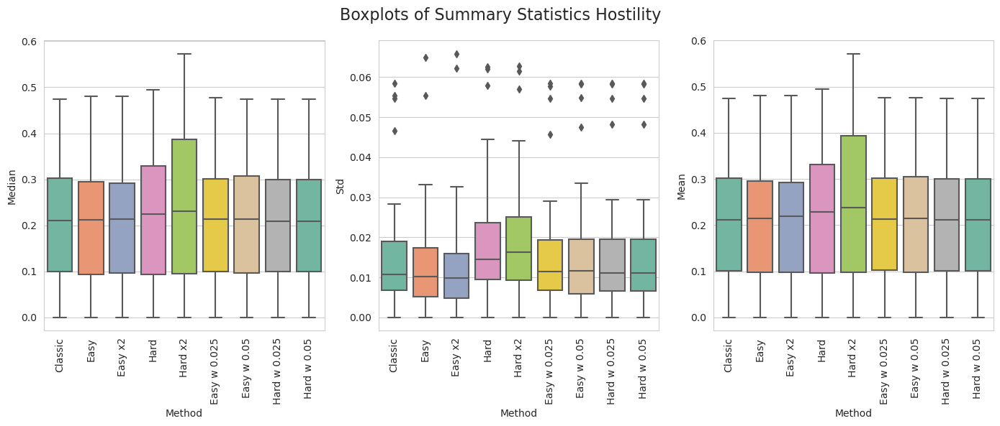

In [56]:
plot_summary_CM(CM,summary_table_CM)

#### Summary table with kDN

In [57]:
CM = 'kDN'
summary_table_CM = summary_CM(CM,all_datasets)
summary_table_CM
#summary_table_CM.to_csv('SummaryStatistics_PerDataset_Boosting_kDN.csv')

,dataset,classic_misc_rate_test_mean_median,error_w_easy_0.025_misc_rate_test_mean_median,error_w_easy_0.05_misc_rate_test_mean_median,error_w_hard_0.025_misc_rate_test_mean_median,error_w_hard_0.05_misc_rate_test_mean_median,init_easy_misc_rate_test_mean_median,init_easy_x2_misc_rate_test_mean_median,init_hard_misc_rate_test_mean_median,init_hard_x2_misc_rate_test_mean_median,...,init_hard_x2_misc_rate_test_mean_std,classic_misc_rate_test_mean_total_mean,error_w_easy_0.025_misc_rate_test_mean_total_mean,error_w_easy_0.05_misc_rate_test_mean_total_mean,error_w_hard_0.025_misc_rate_test_mean_total_mean,error_w_hard_0.05_misc_rate_test_mean_total_mean,init_easy_misc_rate_test_mean_total_mean,init_easy_x2_misc_rate_test_mean_total_mean,init_hard_misc_rate_test_mean_total_mean,init_hard_x2_misc_rate_test_mean_total_mean
0,WineQualityRed_5vs6,0.288145,0.283570,0.290039,0.285843,0.285843,0.289614,0.285074,0.304054,0.348780,...,0.010575,0.291635,0.287517,0.291375,0.288816,0.288816,0.291940,0.286967,0.304582,0.351155
1,Yeast_CYTvsNUC,0.341948,0.343084,0.341960,0.341948,0.341948,0.348652,0.347522,0.354220,0.461923,...,0.009009,0.343420,0.344298,0.343309,0.343313,0.343313,0.349944,0.349707,0.354305,0.462456
2,arrhythmia_cfs,0.167874,0.170193,0.172367,0.167826,0.167826,0.197971,0.212295,0.185725,0.227850,...,0.057427,0.175926,0.177999,0.178434,0.175308,0.175308,0.211059,0.229563,0.205485,0.247852
3,bands,0.312162,0.307057,0.312350,0.309497,0.309497,0.304354,0.304279,0.326239,0.339489,...,0.019293,0.310373,0.306860,0.309757,0.309660,0.309660,0.307889,0.312032,0.329352,0.344501
4,banknote_authentication,0.001455,0.001455,0.001455,0.001455,0.001455,0.003644,0.003644,0.002184,0.001455,...,0.016709,0.006518,0.006545,0.006564,0.006486,0.006486,0.007915,0.008292,0.006210,0.006051
5,bodyfat,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,...,0.000000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000
6,breast-w,0.041470,0.044306,0.042899,0.042899,0.042899,0.042919,0.044348,0.038592,0.034306,...,0.006547,0.042521,0.044082,0.043921,0.043424,0.043424,0.044483,0.045147,0.039198,0.035586
7,breastcancer,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
8,bupa,0.266765,0.266807,0.266555,0.269664,0.269664,0.278403,0.298739,0.272353,0.283866,...,0.026240,0.271157,0.270411,0.268351,0.273273,0.273273,0.284418,0.300168,0.277045,0.289890
9,chatfield_4,0.127717,0.136051,0.127899,0.127536,0.127536,0.123732,0.115217,0.136232,0.140489,...,0.007607,0.126237,0.133056,0.127908,0.126497,0.126497,0.125511,0.117204,0.136354,0.139314


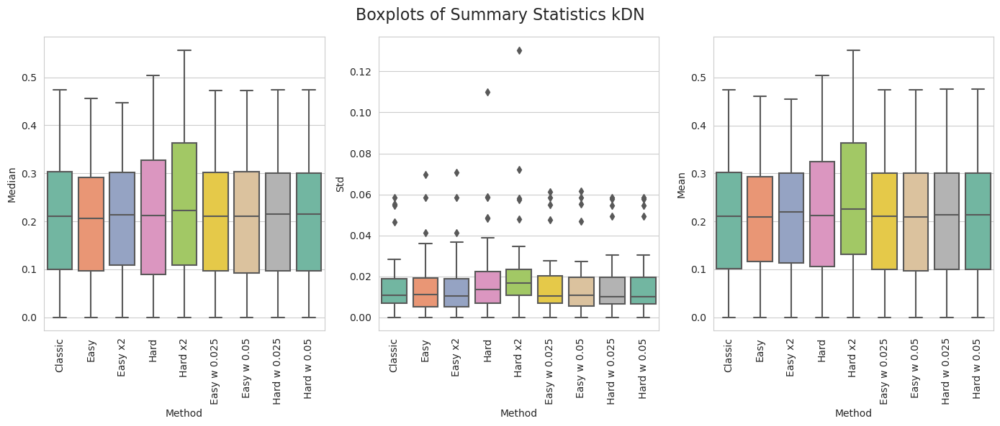

In [58]:
plot_summary_CM(CM,summary_table_CM)

#### Summary table with N1

In [59]:
CM = 'N1'
summary_table_CM = summary_CM(CM,all_datasets)
summary_table_CM
#summary_table_CM.to_csv('SummaryStatistics_PerDataset_Boosting_N1.csv')

,dataset,classic_misc_rate_test_mean_median,error_w_easy_0.025_misc_rate_test_mean_median,error_w_easy_0.05_misc_rate_test_mean_median,error_w_hard_0.025_misc_rate_test_mean_median,error_w_hard_0.05_misc_rate_test_mean_median,init_easy_misc_rate_test_mean_median,init_easy_x2_misc_rate_test_mean_median,init_hard_misc_rate_test_mean_median,init_hard_x2_misc_rate_test_mean_median,...,init_hard_x2_misc_rate_test_mean_std,classic_misc_rate_test_mean_total_mean,error_w_easy_0.025_misc_rate_test_mean_total_mean,error_w_easy_0.05_misc_rate_test_mean_total_mean,error_w_hard_0.025_misc_rate_test_mean_total_mean,error_w_hard_0.05_misc_rate_test_mean_total_mean,init_easy_misc_rate_test_mean_total_mean,init_easy_x2_misc_rate_test_mean_total_mean,init_hard_misc_rate_test_mean_total_mean,init_hard_x2_misc_rate_test_mean_total_mean
0,WineQualityRed_5vs6,0.288145,0.288145,0.289637,0.288133,0.288133,0.287341,0.284698,0.304071,0.320715,...,0.010437,0.291635,0.290373,0.291945,0.290182,0.290182,0.290019,0.286037,0.304131,0.321189
1,Yeast_CYTvsNUC,0.341948,0.343084,0.343071,0.341954,0.341954,0.346454,0.346454,0.347503,0.378914,...,0.011997,0.343420,0.344348,0.343765,0.343027,0.343027,0.346370,0.346226,0.347161,0.376889
2,arrhythmia_cfs,0.167874,0.167874,0.170145,0.170097,0.170097,0.187923,0.194686,0.167850,0.170097,...,0.034547,0.175926,0.175771,0.176509,0.176858,0.176858,0.201469,0.204581,0.177556,0.181088
3,bands,0.312162,0.307095,0.309760,0.306832,0.306832,0.287763,0.295946,0.309610,0.323574,...,0.022881,0.310373,0.307754,0.307218,0.307813,0.307813,0.290320,0.296041,0.313988,0.328920
4,banknote_authentication,0.001455,0.001455,0.001455,0.001455,0.001455,0.001455,0.001455,0.001455,0.001455,...,0.017260,0.006518,0.006518,0.006496,0.006518,0.006518,0.006331,0.006331,0.006369,0.006574
5,bodyfat,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,...,0.000000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000
6,breast-w,0.041470,0.041470,0.041470,0.042899,0.042899,0.037205,0.037205,0.041470,0.042878,...,0.005136,0.042521,0.042516,0.042645,0.043759,0.043759,0.040048,0.038954,0.043022,0.044508
7,breastcancer,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
8,bupa,0.266765,0.269580,0.266471,0.266891,0.266891,0.272353,0.272647,0.295504,0.301261,...,0.023721,0.271157,0.272547,0.268483,0.270805,0.270805,0.274942,0.278661,0.297656,0.302601
9,chatfield_4,0.127717,0.131884,0.123732,0.127536,0.127536,0.136413,0.136504,0.144565,0.140399,...,0.011013,0.126237,0.130018,0.125234,0.126230,0.126230,0.138399,0.135591,0.140133,0.137720


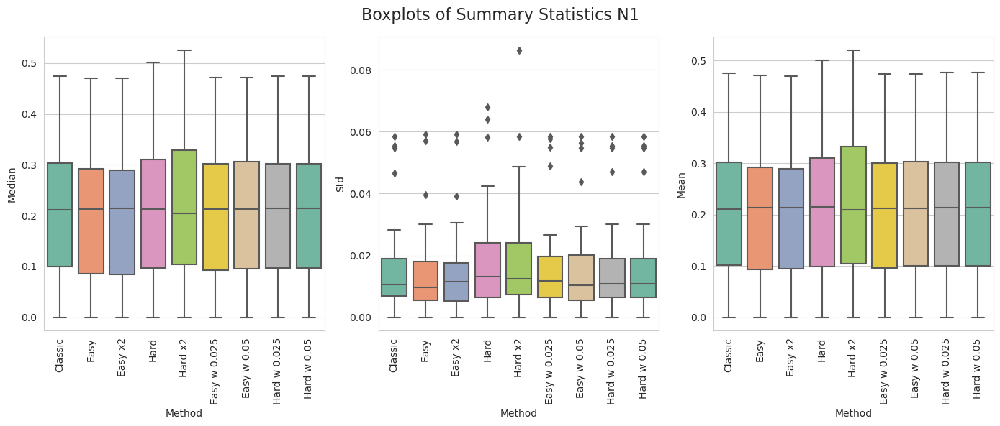

In [60]:
plot_summary_CM(CM,summary_table_CM)

#### Summary table with N2

In [61]:
CM = 'N2'
summary_table_CM = summary_CM(CM,all_datasets)
summary_table_CM
#summary_table_CM.to_csv('SummaryStatistics_PerDataset_Boosting_N2.csv')

,dataset,classic_misc_rate_test_mean_median,error_w_easy_0.025_misc_rate_test_mean_median,error_w_easy_0.05_misc_rate_test_mean_median,error_w_hard_0.025_misc_rate_test_mean_median,error_w_hard_0.05_misc_rate_test_mean_median,init_easy_misc_rate_test_mean_median,init_easy_x2_misc_rate_test_mean_median,init_hard_misc_rate_test_mean_median,init_hard_x2_misc_rate_test_mean_median,...,init_hard_x2_misc_rate_test_mean_std,classic_misc_rate_test_mean_total_mean,error_w_easy_0.025_misc_rate_test_mean_total_mean,error_w_easy_0.05_misc_rate_test_mean_total_mean,error_w_hard_0.025_misc_rate_test_mean_total_mean,error_w_hard_0.05_misc_rate_test_mean_total_mean,init_easy_misc_rate_test_mean_total_mean,init_easy_x2_misc_rate_test_mean_total_mean,init_hard_misc_rate_test_mean_total_mean,init_hard_x2_misc_rate_test_mean_total_mean
0,WineQualityRed_5vs6,0.288145,0.289287,0.287376,0.285479,0.285479,0.300231,0.307790,0.287364,0.288116,...,0.006622,0.291635,0.292597,0.290372,0.289321,0.289321,0.303786,0.307813,0.288078,0.288294
1,Yeast_CYTvsNUC,0.341948,0.341960,0.344207,0.341935,0.341935,0.353171,0.352022,0.329613,0.346392,...,0.007951,0.343420,0.342995,0.344733,0.343342,0.343342,0.355371,0.351961,0.332419,0.348590
2,arrhythmia_cfs,0.167874,0.167874,0.167874,0.167778,0.167778,0.187971,0.187923,0.176715,0.190000,...,0.039702,0.175926,0.176061,0.176013,0.174935,0.174935,0.206895,0.202142,0.183854,0.201036
3,bands,0.312162,0.312237,0.308333,0.310135,0.310135,0.296059,0.321021,0.295796,0.306456,...,0.025954,0.310373,0.308169,0.306364,0.310171,0.310171,0.303083,0.323690,0.300336,0.309656
4,banknote_authentication,0.001455,0.001455,0.001455,0.001455,0.001455,0.004369,0.007283,0.002184,0.006564,...,0.021294,0.006518,0.006523,0.006572,0.006549,0.006549,0.009369,0.011788,0.009892,0.012903
5,bodyfat,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,...,0.000000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000
6,breast-w,0.041470,0.041470,0.041470,0.044327,0.044327,0.041491,0.040062,0.037184,0.037174,...,0.006990,0.042521,0.042807,0.042387,0.045202,0.045202,0.041861,0.040944,0.038534,0.038969
7,breastcancer,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
8,bupa,0.266765,0.266891,0.272521,0.263950,0.263950,0.281008,0.283950,0.272185,0.280924,...,0.020590,0.271157,0.271353,0.275405,0.269554,0.269554,0.280686,0.287574,0.276293,0.283059
9,chatfield_4,0.127717,0.127717,0.127717,0.127536,0.127536,0.132065,0.127899,0.131884,0.136051,...,0.006849,0.126237,0.126874,0.125675,0.128327,0.128327,0.129987,0.128559,0.132194,0.136316


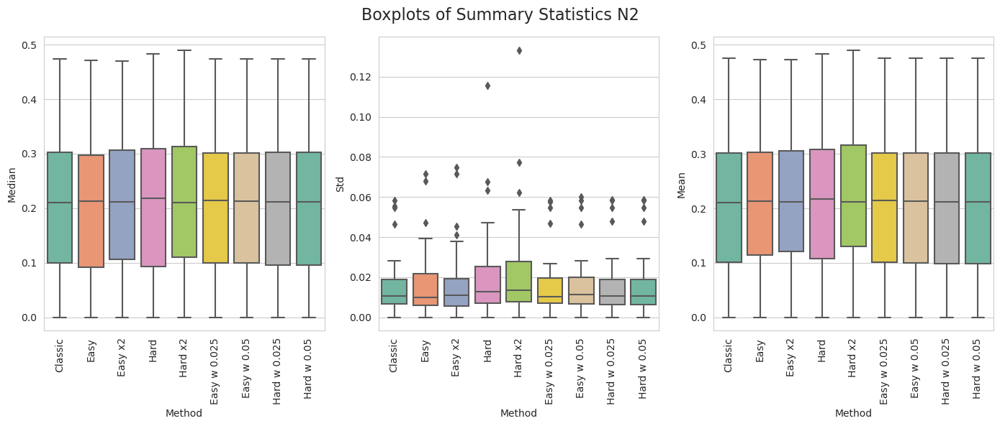

In [62]:
plot_summary_CM(CM,summary_table_CM)

#### Summary table with DCP

In [63]:
CM = 'DCP'
summary_table_CM = summary_CM(CM,all_datasets)
summary_table_CM
#summary_table_CM.to_csv('SummaryStatistics_PerDataset_Boosting_DCP.csv')

,dataset,classic_misc_rate_test_mean_median,error_w_easy_0.025_misc_rate_test_mean_median,error_w_easy_0.05_misc_rate_test_mean_median,error_w_hard_0.025_misc_rate_test_mean_median,error_w_hard_0.05_misc_rate_test_mean_median,init_easy_misc_rate_test_mean_median,init_easy_x2_misc_rate_test_mean_median,init_hard_misc_rate_test_mean_median,init_hard_x2_misc_rate_test_mean_median,...,init_hard_x2_misc_rate_test_mean_std,classic_misc_rate_test_mean_total_mean,error_w_easy_0.025_misc_rate_test_mean_total_mean,error_w_easy_0.05_misc_rate_test_mean_total_mean,error_w_hard_0.025_misc_rate_test_mean_total_mean,error_w_hard_0.05_misc_rate_test_mean_total_mean,init_easy_misc_rate_test_mean_total_mean,init_easy_x2_misc_rate_test_mean_total_mean,init_hard_misc_rate_test_mean_total_mean,init_hard_x2_misc_rate_test_mean_total_mean
0,WineQualityRed_5vs6,0.288145,0.288873,0.287399,0.286618,0.286618,0.319969,0.326793,0.385120,0.467014,...,0.021048,0.291635,0.291699,0.291501,0.289870,0.289870,0.321028,0.328364,0.394379,0.473672
1,Yeast_CYTvsNUC,0.341948,0.343071,0.340849,0.343084,0.343084,0.349775,0.347553,0.478596,0.548152,...,0.009531,0.343420,0.344100,0.342207,0.344351,0.344351,0.349929,0.348126,0.479969,0.551444
2,arrhythmia_cfs,0.167874,0.172222,0.170000,0.167874,0.167874,0.172464,0.172464,0.214324,0.234058,...,0.025883,0.175926,0.177543,0.177062,0.175171,0.175171,0.183009,0.189866,0.224320,0.240241
3,bands,0.312162,0.301502,0.304167,0.301502,0.301502,0.320946,0.328979,0.356306,0.386261,...,0.034610,0.310373,0.304326,0.307401,0.303919,0.303919,0.321716,0.331071,0.366499,0.397515
4,banknote_authentication,0.001455,0.001455,0.001455,0.001455,0.001455,0.002184,0.005459,0.001455,0.002184,...,0.020946,0.006518,0.006559,0.006552,0.006569,0.006569,0.009679,0.012117,0.007323,0.008568
5,bodyfat,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,...,0.000000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000
6,breast-w,0.041470,0.041470,0.041470,0.041470,0.041470,0.050041,0.054369,0.042899,0.041470,...,0.005310,0.042521,0.042859,0.042068,0.042124,0.042124,0.050353,0.054678,0.043109,0.041653
7,breastcancer,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
8,bupa,0.266765,0.272185,0.266597,0.269664,0.269664,0.272437,0.284034,0.295798,0.333445,...,0.018742,0.271157,0.274214,0.270277,0.273075,0.273075,0.279144,0.287417,0.299738,0.335603
9,chatfield_4,0.127717,0.131884,0.123551,0.132065,0.132065,0.127717,0.123551,0.127717,0.136232,...,0.006884,0.126237,0.131621,0.125183,0.132562,0.132562,0.127523,0.123038,0.128161,0.134034


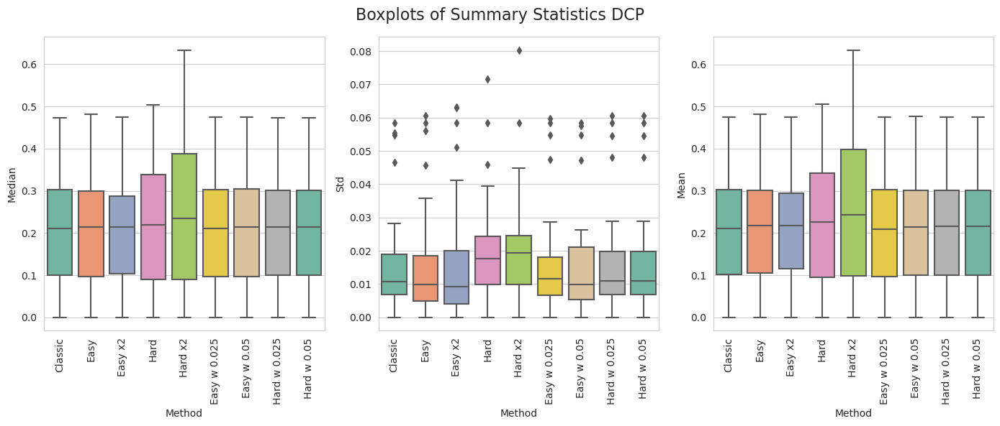

In [64]:
plot_summary_CM(CM,summary_table_CM)

#### Summary table with LSC

In [65]:
CM = 'LSC'
summary_table_CM = summary_CM(CM,all_datasets)
summary_table_CM
#summary_table_CM.to_csv('SummaryStatistics_PerDataset_Boosting_LSC.csv')

,dataset,classic_misc_rate_test_mean_median,error_w_easy_0.025_misc_rate_test_mean_median,error_w_easy_0.05_misc_rate_test_mean_median,error_w_hard_0.025_misc_rate_test_mean_median,error_w_hard_0.05_misc_rate_test_mean_median,init_easy_misc_rate_test_mean_median,init_easy_x2_misc_rate_test_mean_median,init_hard_misc_rate_test_mean_median,init_hard_x2_misc_rate_test_mean_median,...,init_hard_x2_misc_rate_test_mean_std,classic_misc_rate_test_mean_total_mean,error_w_easy_0.025_misc_rate_test_mean_total_mean,error_w_easy_0.05_misc_rate_test_mean_total_mean,error_w_hard_0.025_misc_rate_test_mean_total_mean,error_w_hard_0.05_misc_rate_test_mean_total_mean,init_easy_misc_rate_test_mean_total_mean,init_easy_x2_misc_rate_test_mean_total_mean,init_hard_misc_rate_test_mean_total_mean,init_hard_x2_misc_rate_test_mean_total_mean
0,WineQualityRed_5vs6,0.288145,0.290397,0.289643,0.289648,0.289648,0.291910,0.289625,0.289660,0.306301,...,0.011588,0.291635,0.293252,0.293023,0.291793,0.291793,0.295100,0.289863,0.291380,0.309335
1,Yeast_CYTvsNUC,0.341948,0.341941,0.341948,0.341948,0.341948,0.340849,0.341960,0.332896,0.350811,...,0.005433,0.343420,0.343282,0.343466,0.343192,0.343192,0.341827,0.342296,0.334021,0.351039
2,arrhythmia_cfs,0.167874,0.167874,0.167874,0.165749,0.165749,0.198937,0.205507,0.185604,0.205773,...,0.034840,0.175926,0.175748,0.175988,0.174768,0.174768,0.209377,0.212557,0.198221,0.216572
3,bands,0.312162,0.309685,0.309610,0.309685,0.309685,0.298724,0.307320,0.320571,0.331456,...,0.018976,0.310373,0.307850,0.307548,0.309285,0.309285,0.304034,0.313302,0.323080,0.332278
4,banknote_authentication,0.001455,0.001455,0.001455,0.001455,0.001455,0.004374,0.003644,0.002184,0.002184,...,0.022118,0.006518,0.006494,0.006525,0.006562,0.006562,0.010695,0.013062,0.005690,0.006560
5,bodyfat,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,...,0.000000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000
6,breast-w,0.041470,0.042899,0.041470,0.042899,0.042899,0.041491,0.042919,0.035735,0.038592,...,0.004707,0.042521,0.043340,0.042816,0.044225,0.044225,0.042958,0.046562,0.037314,0.039097
7,breastcancer,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
8,bupa,0.266765,0.266723,0.269580,0.263782,0.263782,0.263992,0.281345,0.275126,0.283697,...,0.018553,0.271157,0.271152,0.272415,0.267675,0.267675,0.269146,0.286186,0.280636,0.284776
9,chatfield_4,0.127717,0.127717,0.127717,0.127717,0.127717,0.132065,0.132246,0.136232,0.136413,...,0.005742,0.126237,0.126734,0.126175,0.125819,0.125819,0.131958,0.133569,0.134398,0.134916


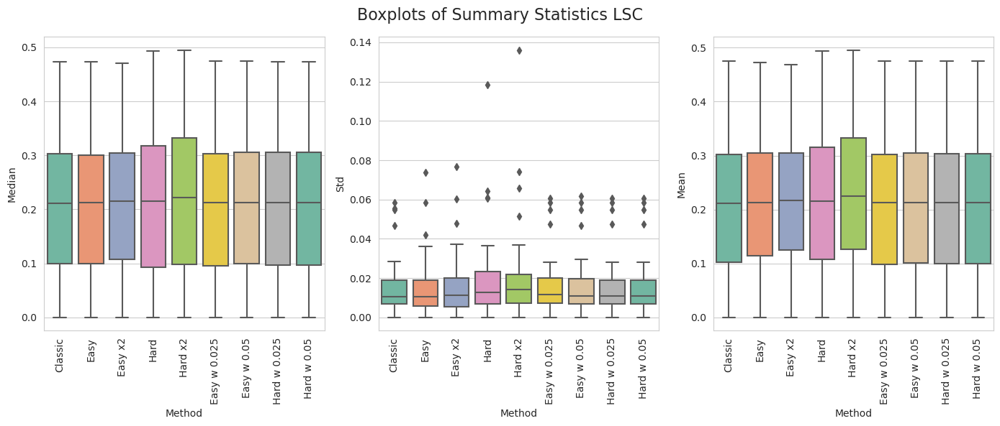

In [66]:
plot_summary_CM(CM,summary_table_CM)

#### Summary table with F1

In [67]:
CM = 'F1'
summary_table_CM = summary_CM(CM,all_datasets)
summary_table_CM
#summary_table_CM.to_csv('SummaryStatistics_PerDataset_Boosting_F1.csv')

,dataset,classic_misc_rate_test_mean_median,error_w_easy_0.025_misc_rate_test_mean_median,error_w_easy_0.05_misc_rate_test_mean_median,error_w_hard_0.025_misc_rate_test_mean_median,error_w_hard_0.05_misc_rate_test_mean_median,init_easy_misc_rate_test_mean_median,init_easy_x2_misc_rate_test_mean_median,init_hard_misc_rate_test_mean_median,init_hard_x2_misc_rate_test_mean_median,...,init_hard_x2_misc_rate_test_mean_std,classic_misc_rate_test_mean_total_mean,error_w_easy_0.025_misc_rate_test_mean_total_mean,error_w_easy_0.05_misc_rate_test_mean_total_mean,error_w_hard_0.025_misc_rate_test_mean_total_mean,error_w_hard_0.05_misc_rate_test_mean_total_mean,init_easy_misc_rate_test_mean_total_mean,init_easy_x2_misc_rate_test_mean_total_mean,init_hard_misc_rate_test_mean_total_mean,init_hard_x2_misc_rate_test_mean_total_mean
0,WineQualityRed_5vs6,0.288145,0.291936,0.287370,0.291164,0.291164,0.297970,0.291158,0.292676,0.301006,...,0.006516,0.291635,0.294442,0.291226,0.294100,0.294100,0.298860,0.292644,0.294868,0.302100
1,Yeast_CYTvsNUC,0.341948,0.341948,0.341960,0.344170,0.344170,0.346417,0.343059,0.355381,0.352022,...,0.003975,0.343420,0.343424,0.343688,0.344508,0.344508,0.346802,0.344117,0.354796,0.352090
2,arrhythmia_cfs,0.167874,0.167923,0.167826,0.167923,0.167923,0.176812,0.192150,0.192271,0.192367,...,0.038644,0.175926,0.175763,0.175224,0.176265,0.176265,0.186609,0.199218,0.202263,0.207595
3,bands,0.312162,0.312312,0.306832,0.315240,0.315240,0.318168,0.331607,0.293056,0.301201,...,0.023100,0.310373,0.311366,0.309562,0.314465,0.314465,0.322015,0.333569,0.295566,0.306562
4,banknote_authentication,0.001455,0.001455,0.002184,0.001455,0.001455,0.002184,0.001455,0.001455,0.001455,...,0.019418,0.006518,0.006530,0.006559,0.006450,0.006450,0.007055,0.007753,0.006234,0.006682
5,bodyfat,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,...,0.000000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000
6,breast-w,0.041470,0.042899,0.041470,0.044306,0.044306,0.041491,0.041491,0.037184,0.035735,...,0.006525,0.042521,0.043369,0.042483,0.044669,0.044669,0.043060,0.043489,0.038273,0.036482
7,breastcancer,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
8,bupa,0.266765,0.263866,0.266723,0.269622,0.269622,0.269538,0.281429,0.287059,0.295882,...,0.014156,0.271157,0.267952,0.270632,0.273759,0.273759,0.273166,0.286960,0.288945,0.297490
9,chatfield_4,0.127717,0.127717,0.127536,0.127717,0.127717,0.140399,0.140399,0.136413,0.132065,...,0.004654,0.126237,0.125297,0.125709,0.126074,0.126074,0.140968,0.138922,0.138658,0.131618


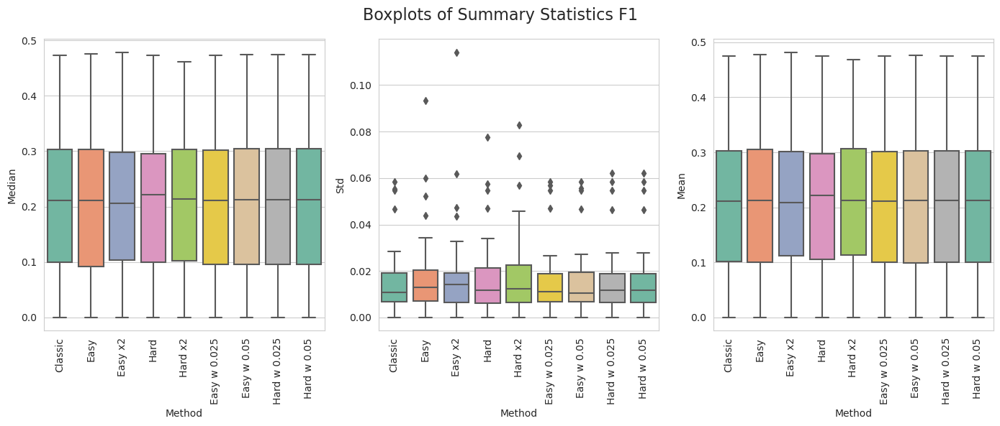

In [68]:
plot_summary_CM(CM,summary_table_CM)

#### Summary table with TD_U

In [69]:
CM = 'TD_U'
summary_table_CM = summary_CM(CM,all_datasets)
summary_table_CM
#summary_table_CM.to_csv('SummaryStatistics_PerDataset_Boosting_TDU.csv')

,dataset,classic_misc_rate_test_mean_median,error_w_easy_0.025_misc_rate_test_mean_median,error_w_easy_0.05_misc_rate_test_mean_median,error_w_hard_0.025_misc_rate_test_mean_median,error_w_hard_0.05_misc_rate_test_mean_median,init_easy_misc_rate_test_mean_median,init_easy_x2_misc_rate_test_mean_median,init_hard_misc_rate_test_mean_median,init_hard_x2_misc_rate_test_mean_median,...,init_hard_x2_misc_rate_test_mean_std,classic_misc_rate_test_mean_total_mean,error_w_easy_0.025_misc_rate_test_mean_total_mean,error_w_easy_0.05_misc_rate_test_mean_total_mean,error_w_hard_0.025_misc_rate_test_mean_total_mean,error_w_hard_0.05_misc_rate_test_mean_total_mean,init_easy_misc_rate_test_mean_total_mean,init_easy_x2_misc_rate_test_mean_total_mean,init_hard_misc_rate_test_mean_total_mean,init_hard_x2_misc_rate_test_mean_total_mean
0,WineQualityRed_5vs6,0.288145,0.281321,0.285094,0.290397,0.290397,0.294188,0.300254,0.296443,0.301758,...,0.009635,0.291635,0.287080,0.288764,0.292481,0.292481,0.293758,0.299890,0.299445,0.304583
1,Yeast_CYTvsNUC,0.341948,0.341948,0.341960,0.344195,0.344195,0.337453,0.343059,0.352066,0.359844,...,0.004870,0.343420,0.343706,0.343076,0.344471,0.344471,0.339626,0.343124,0.351940,0.360320
2,arrhythmia_cfs,0.167874,0.170097,0.174444,0.170097,0.170097,0.203382,0.229710,0.187826,0.212174,...,0.035613,0.175926,0.176663,0.181002,0.177663,0.177663,0.216578,0.247836,0.208448,0.226598
3,bands,0.312162,0.297335,0.306682,0.306982,0.306982,0.323273,0.339940,0.312387,0.328679,...,0.017033,0.310373,0.301086,0.307571,0.309271,0.309271,0.325984,0.342977,0.318233,0.331960
4,banknote_authentication,0.001455,0.001455,0.001455,0.001455,0.001455,0.002909,0.004369,0.001455,0.003644,...,0.021574,0.006518,0.006540,0.006426,0.006479,0.006479,0.009503,0.011982,0.009695,0.011862
5,bodyfat,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,...,0.000000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000
6,breast-w,0.041470,0.042899,0.042899,0.042899,0.042899,0.041449,0.045735,0.047205,0.044369,...,0.007805,0.042521,0.043706,0.043482,0.043335,0.043335,0.042447,0.046372,0.047340,0.047609
7,breastcancer,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
8,bupa,0.266765,0.266639,0.263613,0.263739,0.263739,0.263866,0.284454,0.275462,0.289580,...,0.026927,0.271157,0.269713,0.267537,0.267871,0.267871,0.268405,0.289845,0.282097,0.295597
9,chatfield_4,0.127717,0.127717,0.127536,0.127717,0.127717,0.123551,0.127899,0.140217,0.140399,...,0.005488,0.126237,0.125647,0.125546,0.127847,0.127847,0.124229,0.129227,0.139276,0.138654


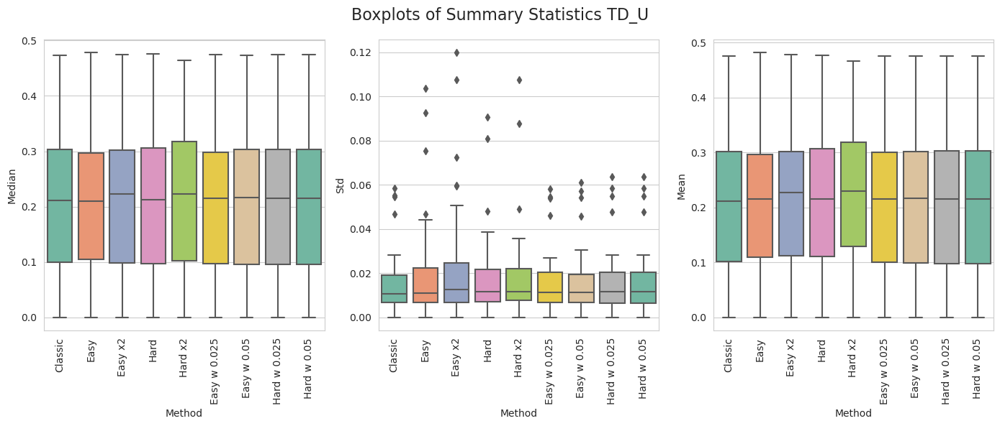

In [70]:
plot_summary_CM(CM,summary_table_CM)

#### Summary table with CLD

In [71]:
CM = 'CLD'
summary_table_CM = summary_CM(CM,all_datasets)
summary_table_CM
#summary_table_CM.to_csv('SummaryStatistics_PerDataset_Boosting_CLD.csv')

,dataset,classic_misc_rate_test_mean_median,error_w_easy_0.025_misc_rate_test_mean_median,error_w_easy_0.05_misc_rate_test_mean_median,error_w_hard_0.025_misc_rate_test_mean_median,error_w_hard_0.05_misc_rate_test_mean_median,init_easy_misc_rate_test_mean_median,init_easy_x2_misc_rate_test_mean_median,init_hard_misc_rate_test_mean_median,init_hard_x2_misc_rate_test_mean_median,...,init_hard_x2_misc_rate_test_mean_std,classic_misc_rate_test_mean_total_mean,error_w_easy_0.025_misc_rate_test_mean_total_mean,error_w_easy_0.05_misc_rate_test_mean_total_mean,error_w_hard_0.025_misc_rate_test_mean_total_mean,error_w_hard_0.05_misc_rate_test_mean_total_mean,init_easy_misc_rate_test_mean_total_mean,init_easy_x2_misc_rate_test_mean_total_mean,init_hard_misc_rate_test_mean_total_mean,init_hard_x2_misc_rate_test_mean_total_mean
0,WineQualityRed_5vs6,0.288145,0.285091,0.288897,0.285100,0.285100,0.286589,0.291516,0.392725,0.498112,...,0.013303,0.291635,0.288343,0.290970,0.290557,0.290557,0.287739,0.292939,0.397640,0.502923
1,Yeast_CYTvsNUC,0.341948,0.341935,0.341948,0.341948,0.341948,0.383421,0.406991,0.486554,0.492715,...,0.002038,0.343420,0.343169,0.343372,0.343982,0.343982,0.387071,0.407659,0.486162,0.492812
2,arrhythmia_cfs,0.167874,0.165773,0.167923,0.167899,0.167899,0.178986,0.194589,0.240773,0.274155,...,0.022821,0.175926,0.174314,0.175613,0.175584,0.175584,0.189544,0.200284,0.245211,0.276399
3,bands,0.312162,0.304204,0.304129,0.301426,0.301426,0.345495,0.359009,0.378303,0.410961,...,0.023380,0.310373,0.309303,0.305003,0.302051,0.302051,0.347237,0.359354,0.382962,0.419889
4,banknote_authentication,0.001455,0.002184,0.001455,0.001455,0.001455,0.005094,0.010571,0.002184,0.002184,...,0.036020,0.006518,0.006445,0.006355,0.006362,0.006362,0.013553,0.018699,0.007770,0.012005
5,bodyfat,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,...,0.000000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000
6,breast-w,0.041470,0.042899,0.041470,0.040041,0.040041,0.045797,0.047246,0.035735,0.037164,...,0.006035,0.042521,0.043435,0.042305,0.041262,0.041262,0.046037,0.048386,0.036865,0.038095
7,breastcancer,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
8,bupa,0.266765,0.266807,0.266723,0.263866,0.263866,0.295462,0.318697,0.369874,0.431597,...,0.032334,0.271157,0.270938,0.270557,0.268938,0.268938,0.305360,0.324827,0.378869,0.436005
9,chatfield_4,0.127717,0.127899,0.131884,0.123551,0.123551,0.136413,0.132428,0.136051,0.144928,...,0.010462,0.126237,0.130444,0.132037,0.126609,0.126609,0.136845,0.133657,0.134868,0.144065


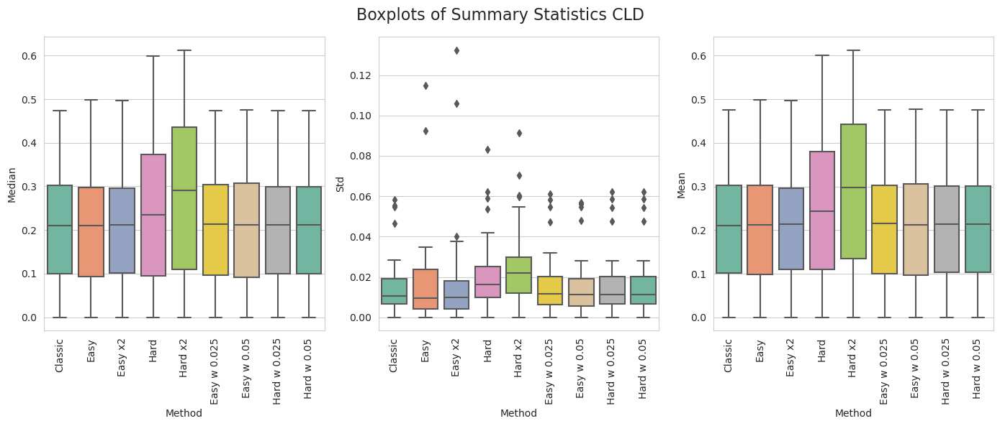

In [72]:
plot_summary_CM(CM,summary_table_CM)

In [73]:
all_datasets.head()

,dataset,n_ensemble,method_weights,compl_measure,exp_loss_avg_train_mean,misc_rate_train_mean,misc_rate_test_mean,exp_loss_avg_train_std,misc_rate_train_std,misc_rate_test_std,conf_matrix_test_total
0,ring,1,classic,none,1.277231,0.386892,0.386892,0.002867,0.001220,0.010979,"[[915, 2749], [114, 3622]]"
1,ring,2,classic,none,1.277231,0.386892,0.386892,0.002867,0.001220,0.010979,"[[915, 2749], [114, 3622]]"
2,ring,3,classic,none,1.093469,0.308709,0.314189,0.006300,0.002680,0.013305,"[[1614, 2050], [275, 3461]]"
3,ring,4,classic,none,1.093469,0.308709,0.314189,0.006300,0.002680,0.013305,"[[1614, 2050], [275, 3461]]"
4,ring,5,classic,none,0.972490,0.257237,0.264324,0.002533,0.001078,0.014459,"[[2101, 1563], [393, 3343]]"


#### Graph analysis per complexity measure and per dataset

In [121]:
def plot_per_CM_dataset(CM,dataset):
    # Grid dimensiones
    num_datasets = dataset['dataset'].nunique()
    num_cols = 4  # Ajusta esto según el diseño que prefieras
    num_rows = math.ceil(num_datasets / num_cols)

    # Configura el tamaño de la figura
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(num_cols * 4, num_rows * 4), sharex=True, sharey=False)
    fig.suptitle('Misclassification Rate Test across Datasets for: '+CM, fontsize=18)

    all_datasets_CM = dataset.loc[(dataset['compl_measure'] == CM) | (dataset['compl_measure'] == 'none'),:]

    # Itera sobre cada dataset y subtrama correspondiente
    for i, (name_dataset, data) in enumerate(all_datasets_CM.groupby('dataset')):
        row = i // num_cols
        col = i % num_cols
        ax = axes[row, col]  # Selecciona el subplot correspondiente

        # Crear el gráfico de líneas para el dataset actual
        sns.lineplot(data=data, x='n_ensemble', y='misc_rate_test_mean', hue='method_weights',
                     #marker='.',
                     palette=colour_palette_personalized, ax=ax, legend=False)

        # Configuración de cada subplot
        ax.set_title(f'{name_dataset}')
        #ax.set_xlabel('n_ensemble')
        #ax.set_ylabel('misc_rate_test_mean')
        ax.set_xticks(range(1, 301, 50))
        ax.grid(True)

    # Agrega una leyenda global fuera de la cuadrícula de gráficos
    handles, labels = ax.get_legend_handles_labels()
    fig.legend(handles, labels, title='Method', loc='upper center', bbox_to_anchor=(0.5, -0.05), ncol=5, fontsize=12)
    # 
    # # add legend
    # handles, labels = ax.get_legend_handles_labels()
    # fig.legend(handles, labels, loc='upper right', ncol=3, bbox_to_anchor=(0.8, 1), frameon=False)


    # Ajusta el diseño para que no se superpongan las gráficas y la leyenda global
    plt.tight_layout(rect=[0, 0.05, 1, 0.95])  # Ajusta para dejar espacio para el título y la leyenda
    plt.show()
    return

In [119]:
# Reordenamos para que al pintar siempre se pinte el último el métod classic y facilite la comparación
all_datasets_reordenada = pd.concat([
    all_datasets[all_datasets['method_weights'] != 'classic'],  
    all_datasets[all_datasets['method_weights'] == 'classic']   
])

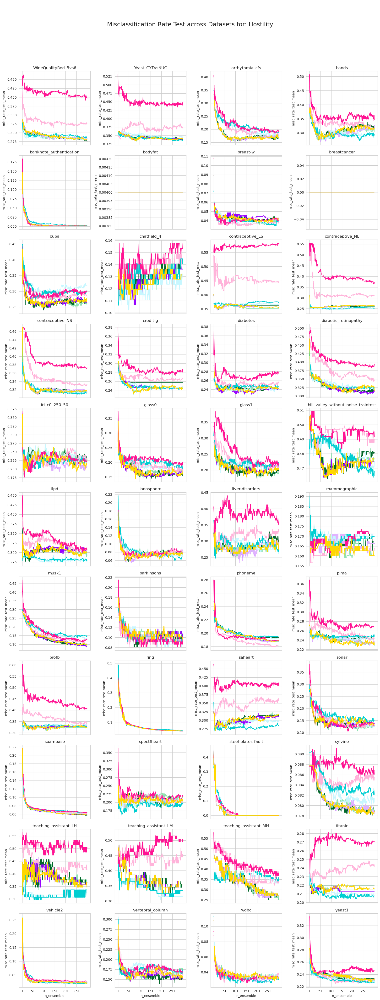

In [120]:
CM = 'Hostility'
plot_per_CM_dataset(CM,all_datasets_reordenada)

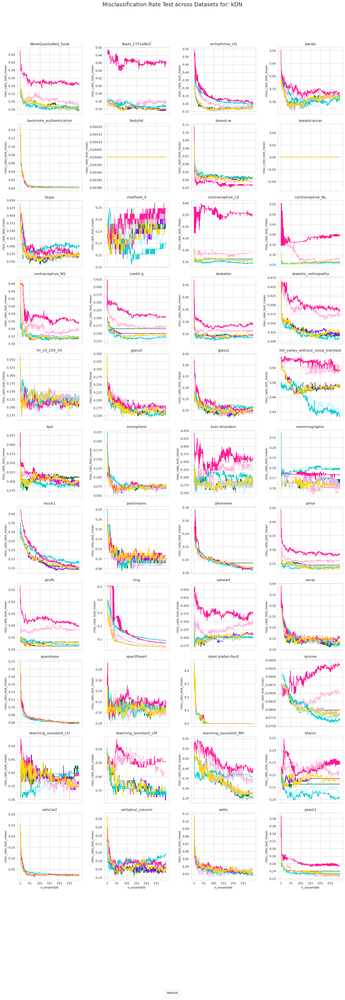

In [98]:
CM = 'kDN'
plot_per_CM_dataset(CM,all_datasets_reordenada)

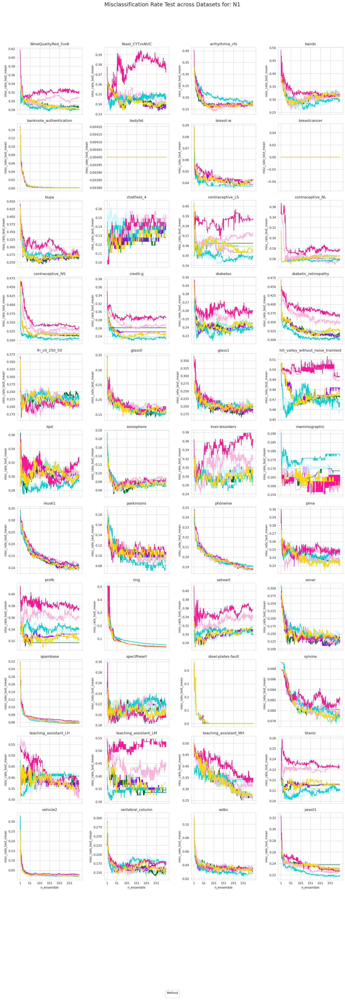

In [103]:
CM = 'N1'
plot_per_CM_dataset(CM,all_datasets_reordenada)

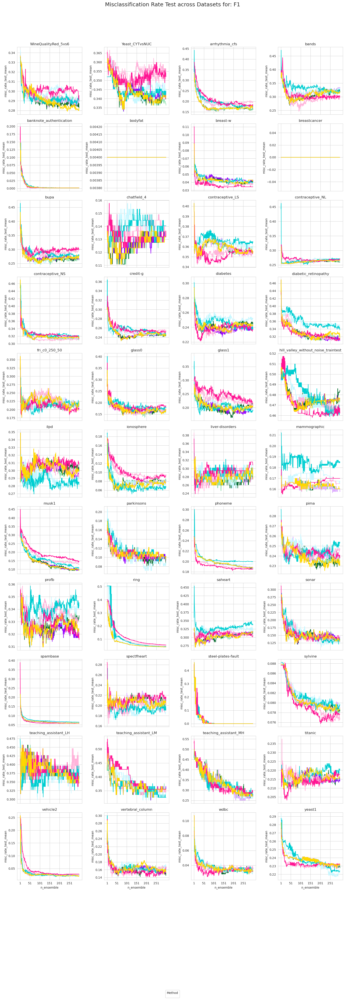

In [99]:
CM = 'F1'
plot_per_CM_dataset(CM,all_datasets_reordenada)

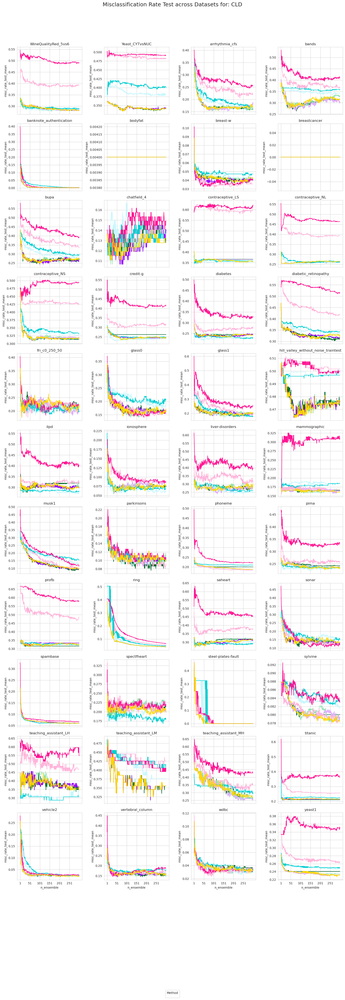

In [104]:
CM = 'CLD'
plot_per_CM_dataset(CM,all_datasets_reordenada)

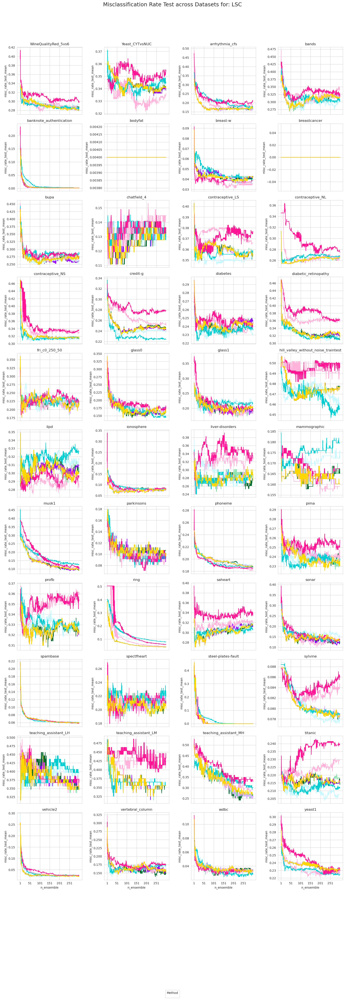

In [100]:
CM = 'LSC'
plot_per_CM_dataset(CM,all_datasets_reordenada)

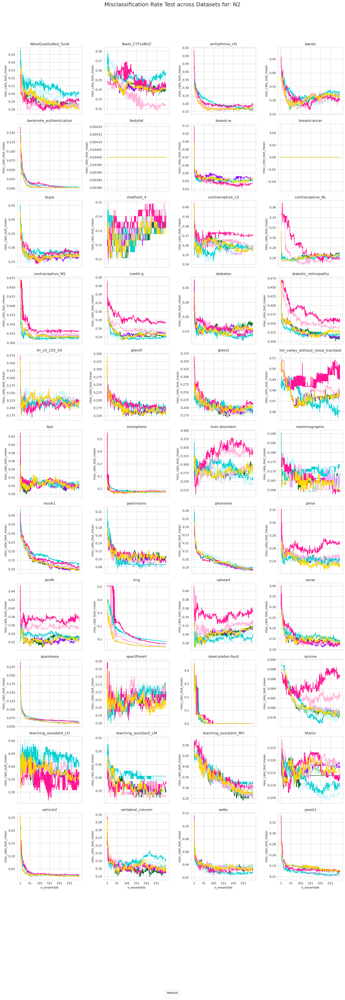

In [101]:
CM = 'N2'
plot_per_CM_dataset(CM,all_datasets_reordenada)

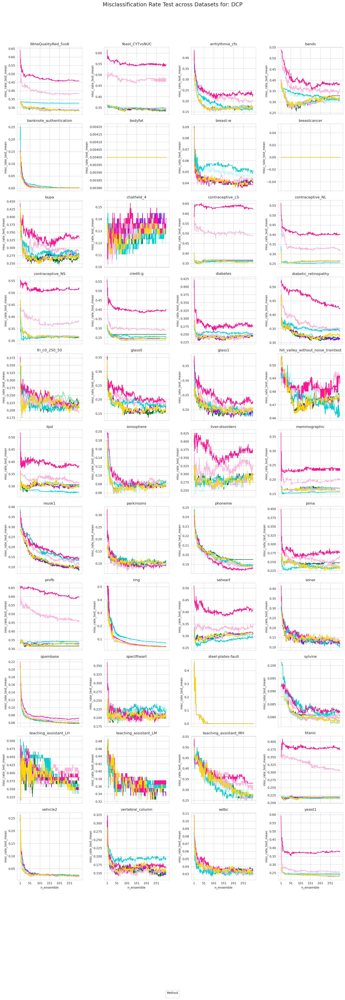

In [105]:
CM = 'DCP'
plot_per_CM_dataset(CM,all_datasets_reordenada)

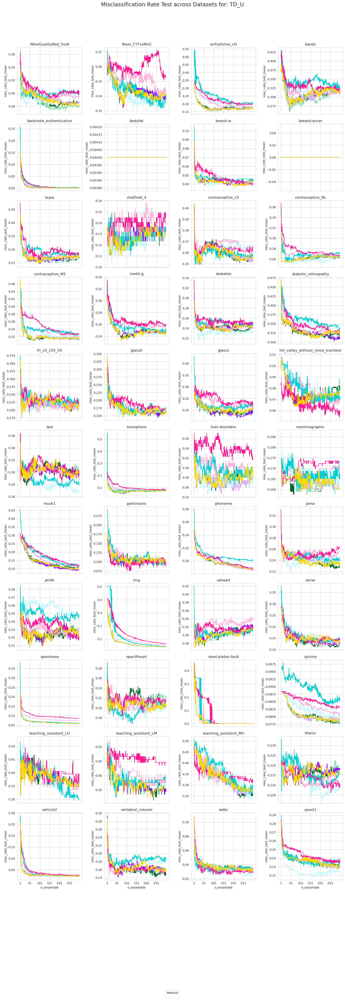

In [102]:
CM = 'TD_U'
plot_per_CM_dataset(CM,all_datasets_reordenada)

### WTL Analysis per complexity measure and method

Init_hard gets generally worse results than init_easy

In [85]:

def win_tie_loss_comparison(data, main_method, compare_method, metric='misc_rate_test_mean',
                            n_ensemble_values=[10, 25, 50, 100, 150, 200, 250, 300]):
    """
    Realiza un análisis win-tie-loss comparando el método principal con otro método específico para cada medida de complejidad.

    Parameters:
    - data: DataFrame con las columnas ['dataset', 'n_ensemble', 'method_weights', 'compl_measure', metric]
    - main_method: método principal que se desea comparar (ejemplo: 'classic')
    - compare_method: método específico con el cual comparar el principal (ejemplo: 'init_easy')
    - metric: métrica de comparación (por defecto 'misc_rate_test_mean')
    - n_ensemble_values: valores de n_ensemble a considerar

    Returns:
    - Una tabla con el conteo de wins, ties, y losses por cada valor de n_ensemble y medida de complejidad.
    """
    results = []

    for n in n_ensemble_values:
        # Filtrar los datos para el valor actual de n_ensemble
        subset_n = data[data['n_ensemble'] == n]


        # Crear un diccionario para almacenar los resultados de esta combinación de n_ensemble
        row = {'n_ensemble': n}

        CM_list = subset_n['compl_measure'].unique()[1:] # to delete none

        for compl in CM_list:
            win, tie, loss = 0, 0, 0

            # Filtrar los datos para la medida de complejidad actual
            subset_compl = subset_n[subset_n['compl_measure'] == compl]
            #if (main_method == 'classic') or (compare_method == 'classic'):
            #     subset_compl_main = subset_n[subset_n['compl_measure'] == 'none']

            for dataset in subset_compl['dataset'].unique():
                # Filtrar para el dataset y métod en cuestión

                if (main_method == 'classic'):
                    subset_compl_main = subset_n[subset_n['compl_measure'] == 'none']
                    main_value = subset_compl_main[(subset_compl_main['dataset'] == dataset) & (subset_compl_main['method_weights'] == main_method)][metric].values
                else:
                    main_value = subset_compl[(subset_compl['dataset'] == dataset) & (subset_compl['method_weights'] == main_method)][metric].values
                if (compare_method == 'classic'):
                    subset_compl_compare = subset_n[subset_n['compl_measure'] == 'none']
                    compare_value = subset_compl_compare[(subset_compl_compare['dataset'] == dataset) & (subset_compl_compare['method_weights'] == compare_method)][metric].values
                else:
                    compare_value = subset_compl[(subset_compl['dataset'] == dataset) & (subset_compl['method_weights'] == compare_method)][metric].values

                # Verificar que tenemos valores únicos para cada dataset y métod
                if main_value.size > 0 and compare_value.size > 0:
                    main_value = main_value[0]
                    compare_value = compare_value[0]

                    # Comparación win-tie-loss
                    if main_value < compare_value:
                        win += 1
                    elif main_value == compare_value:
                        tie += 1
                    else:
                        loss += 1

            # Guardar el resultado para esta medida de complejidad en una columna específica
            row[f'{compare_method}_{compl}'] = (win, tie, loss)

        # Agregar el resultado de esta iteración a los resultados
        results.append(row)

    # Convertir los resultados a DataFrame
    win_tie_loss_df = pd.DataFrame(results)
    return win_tie_loss_df




Here we're comparing classic method vs init_easy with all complexity measures. The results are in the form (W,T,L) from the point of view of classic. Thus, the higher the number of losses, the better for us.

In [86]:
result_table = win_tie_loss_comparison(all_datasets, main_method='classic', compare_method='init_easy')
result_table

,n_ensemble,init_easy_Hostility,init_easy_kDN,init_easy_DCP,init_easy_TD_U,init_easy_CLD,init_easy_N1,init_easy_N2,init_easy_LSC,init_easy_F1
0,10,"(22, 3, 19)","(20, 2, 22)","(27, 3, 14)","(26, 2, 16)","(25, 2, 17)","(15, 4, 25)","(21, 2, 21)","(19, 3, 22)","(25, 3, 16)"
1,25,"(22, 3, 19)","(22, 2, 20)","(25, 4, 15)","(26, 3, 15)","(29, 2, 13)","(21, 4, 19)","(23, 2, 19)","(24, 3, 17)","(25, 3, 16)"
2,50,"(23, 2, 19)","(21, 2, 21)","(27, 3, 14)","(26, 3, 15)","(27, 2, 15)","(22, 2, 20)","(24, 3, 17)","(24, 2, 18)","(28, 3, 13)"
3,100,"(25, 3, 16)","(25, 3, 16)","(27, 4, 13)","(28, 3, 13)","(26, 3, 15)","(20, 4, 20)","(23, 4, 17)","(27, 2, 15)","(30, 4, 10)"
4,150,"(22, 5, 17)","(20, 5, 19)","(25, 4, 15)","(24, 4, 16)","(23, 3, 18)","(17, 6, 21)","(21, 3, 20)","(23, 3, 18)","(26, 5, 13)"
5,200,"(23, 5, 16)","(17, 3, 24)","(23, 7, 14)","(28, 4, 12)","(24, 3, 17)","(16, 6, 22)","(19, 4, 21)","(21, 7, 16)","(24, 5, 15)"
6,250,"(20, 6, 18)","(21, 4, 19)","(21, 4, 19)","(22, 4, 18)","(28, 3, 13)","(18, 5, 21)","(25, 4, 15)","(21, 4, 19)","(21, 6, 17)"
7,300,"(20, 4, 20)","(20, 4, 20)","(20, 6, 18)","(20, 5, 19)","(26, 3, 15)","(18, 4, 22)","(23, 5, 16)","(19, 5, 20)","(22, 5, 17)"


In [87]:
result_table = win_tie_loss_comparison(all_datasets, main_method='classic', compare_method='init_easy_x2')
result_table

,n_ensemble,init_easy_x2_Hostility,init_easy_x2_kDN,init_easy_x2_DCP,init_easy_x2_TD_U,init_easy_x2_CLD,init_easy_x2_N1,init_easy_x2_N2,init_easy_x2_LSC,init_easy_x2_F1
0,10,"(21, 2, 21)","(20, 3, 21)","(27, 3, 14)","(34, 2, 8)","(25, 3, 16)","(15, 3, 26)","(23, 2, 19)","(22, 3, 19)","(27, 3, 14)"
1,25,"(24, 2, 18)","(23, 3, 18)","(27, 3, 14)","(32, 4, 8)","(33, 2, 9)","(20, 2, 22)","(24, 3, 17)","(26, 3, 15)","(22, 2, 20)"
2,50,"(26, 2, 16)","(25, 2, 17)","(29, 3, 12)","(34, 2, 8)","(32, 2, 10)","(21, 2, 21)","(30, 2, 12)","(23, 4, 17)","(29, 2, 13)"
3,100,"(26, 2, 16)","(19, 3, 22)","(30, 4, 10)","(30, 2, 12)","(29, 3, 12)","(21, 6, 17)","(27, 3, 14)","(25, 3, 16)","(29, 2, 13)"
4,150,"(25, 3, 16)","(18, 5, 21)","(27, 3, 14)","(28, 4, 12)","(31, 3, 10)","(17, 4, 23)","(26, 3, 15)","(24, 3, 17)","(27, 4, 13)"
5,200,"(23, 5, 16)","(16, 4, 24)","(26, 4, 14)","(26, 4, 14)","(25, 3, 16)","(17, 4, 23)","(23, 4, 17)","(20, 5, 19)","(28, 5, 11)"
6,250,"(20, 3, 21)","(20, 3, 21)","(25, 4, 15)","(29, 5, 10)","(26, 4, 14)","(18, 6, 20)","(25, 4, 15)","(23, 4, 17)","(27, 4, 13)"
7,300,"(21, 4, 19)","(20, 4, 20)","(26, 3, 15)","(32, 3, 9)","(27, 5, 12)","(14, 5, 25)","(21, 4, 19)","(21, 7, 16)","(25, 4, 15)"


In [88]:
result_table = win_tie_loss_comparison(all_datasets, main_method='classic', compare_method='init_hard')
result_table

,n_ensemble,init_hard_Hostility,init_hard_kDN,init_hard_DCP,init_hard_TD_U,init_hard_CLD,init_hard_N1,init_hard_N2,init_hard_LSC,init_hard_F1
0,10,"(27, 3, 14)","(31, 3, 10)","(32, 3, 9)","(32, 4, 8)","(35, 3, 6)","(23, 4, 17)","(26, 3, 15)","(28, 2, 14)","(21, 3, 20)"
1,25,"(28, 3, 13)","(29, 3, 12)","(35, 3, 6)","(34, 3, 7)","(32, 3, 9)","(28, 3, 13)","(27, 4, 13)","(27, 2, 15)","(21, 2, 21)"
2,50,"(33, 2, 9)","(32, 2, 10)","(35, 4, 5)","(33, 2, 9)","(36, 2, 6)","(29, 2, 13)","(31, 3, 10)","(27, 3, 14)","(25, 3, 16)"
3,100,"(34, 2, 8)","(33, 3, 8)","(30, 4, 10)","(35, 4, 5)","(33, 4, 7)","(30, 4, 10)","(23, 4, 17)","(30, 4, 10)","(21, 4, 19)"
4,150,"(32, 5, 7)","(30, 4, 10)","(33, 5, 6)","(29, 6, 9)","(32, 4, 8)","(26, 5, 13)","(21, 5, 18)","(22, 6, 16)","(18, 5, 21)"
5,200,"(32, 5, 7)","(30, 6, 8)","(32, 4, 8)","(26, 4, 14)","(32, 3, 9)","(28, 5, 11)","(22, 6, 16)","(28, 3, 13)","(19, 6, 19)"
6,250,"(33, 4, 7)","(28, 5, 11)","(33, 4, 7)","(26, 5, 13)","(33, 4, 7)","(33, 4, 7)","(27, 4, 13)","(27, 4, 13)","(24, 4, 16)"
7,300,"(33, 5, 6)","(30, 5, 9)","(35, 5, 4)","(28, 4, 12)","(32, 4, 8)","(28, 4, 12)","(24, 4, 16)","(24, 5, 15)","(24, 4, 16)"


In [89]:
result_table = win_tie_loss_comparison(all_datasets, main_method='classic', compare_method='init_hard_x2')
result_table

,n_ensemble,init_hard_x2_Hostility,init_hard_x2_kDN,init_hard_x2_DCP,init_hard_x2_TD_U,init_hard_x2_CLD,init_hard_x2_N1,init_hard_x2_N2,init_hard_x2_LSC,init_hard_x2_F1
0,10,"(35, 2, 7)","(35, 2, 7)","(37, 3, 4)","(35, 2, 7)","(40, 2, 2)","(30, 4, 10)","(23, 2, 19)","(32, 3, 9)","(25, 2, 17)"
1,25,"(32, 2, 10)","(36, 2, 6)","(39, 3, 2)","(34, 3, 7)","(37, 2, 5)","(35, 2, 7)","(28, 3, 13)","(32, 2, 10)","(26, 2, 16)"
2,50,"(37, 2, 5)","(34, 2, 8)","(38, 3, 3)","(34, 2, 8)","(37, 2, 5)","(33, 2, 9)","(34, 2, 8)","(34, 2, 8)","(22, 2, 20)"
3,100,"(37, 2, 5)","(36, 4, 4)","(34, 4, 6)","(36, 2, 6)","(39, 2, 3)","(34, 4, 6)","(28, 4, 12)","(35, 3, 6)","(22, 5, 17)"
4,150,"(35, 3, 6)","(36, 4, 4)","(35, 4, 5)","(33, 3, 8)","(35, 4, 5)","(30, 5, 9)","(28, 3, 13)","(30, 4, 10)","(24, 4, 16)"
5,200,"(36, 3, 5)","(33, 4, 7)","(33, 4, 7)","(32, 5, 7)","(35, 4, 5)","(29, 6, 9)","(25, 3, 16)","(31, 4, 9)","(21, 5, 18)"
6,250,"(38, 3, 3)","(32, 5, 7)","(35, 4, 5)","(34, 4, 6)","(37, 4, 3)","(32, 4, 8)","(28, 4, 12)","(33, 4, 7)","(22, 7, 15)"
7,300,"(35, 5, 4)","(33, 4, 7)","(34, 4, 6)","(31, 4, 9)","(35, 4, 5)","(31, 4, 9)","(26, 5, 13)","(30, 5, 9)","(22, 5, 17)"


In [90]:
result_table = win_tie_loss_comparison(all_datasets, main_method='classic', compare_method='error_w_easy_0.025')
result_table

,n_ensemble,error_w_easy_0.025_Hostility,error_w_easy_0.025_kDN,error_w_easy_0.025_DCP,error_w_easy_0.025_TD_U,error_w_easy_0.025_CLD,error_w_easy_0.025_N1,error_w_easy_0.025_N2,error_w_easy_0.025_LSC,error_w_easy_0.025_F1
0,10,"(6, 28, 10)","(7, 25, 12)","(6, 25, 13)","(3, 34, 7)","(3, 31, 10)","(6, 26, 12)","(4, 35, 5)","(2, 40, 2)","(2, 38, 4)"
1,25,"(8, 19, 17)","(11, 13, 20)","(15, 9, 20)","(14, 20, 10)","(11, 17, 16)","(12, 14, 18)","(14, 19, 11)","(4, 37, 3)","(9, 26, 9)"
2,50,"(17, 9, 18)","(18, 9, 17)","(15, 7, 22)","(17, 12, 15)","(17, 13, 14)","(19, 10, 15)","(15, 13, 16)","(8, 25, 11)","(13, 13, 18)"
3,100,"(16, 8, 20)","(18, 8, 18)","(16, 9, 19)","(18, 8, 18)","(20, 8, 16)","(16, 6, 22)","(18, 11, 15)","(12, 21, 11)","(18, 10, 16)"
4,150,"(26, 5, 13)","(22, 6, 16)","(20, 9, 15)","(16, 10, 18)","(24, 6, 14)","(22, 5, 17)","(23, 7, 14)","(11, 21, 12)","(15, 13, 16)"
5,200,"(18, 7, 19)","(12, 9, 23)","(13, 6, 25)","(15, 6, 23)","(14, 6, 24)","(14, 9, 21)","(21, 9, 14)","(14, 14, 16)","(17, 10, 17)"
6,250,"(15, 5, 24)","(15, 6, 23)","(19, 8, 17)","(17, 10, 17)","(17, 9, 18)","(21, 6, 17)","(17, 10, 17)","(9, 17, 18)","(13, 10, 21)"
7,300,"(17, 7, 20)","(17, 5, 22)","(18, 6, 20)","(20, 7, 17)","(19, 6, 19)","(18, 9, 17)","(21, 7, 16)","(15, 11, 18)","(20, 9, 15)"


In [91]:
result_table = win_tie_loss_comparison(all_datasets, main_method='classic', compare_method='error_w_easy_0.05')
result_table

,n_ensemble,error_w_easy_0.05_Hostility,error_w_easy_0.05_kDN,error_w_easy_0.05_DCP,error_w_easy_0.05_TD_U,error_w_easy_0.05_CLD,error_w_easy_0.05_N1,error_w_easy_0.05_N2,error_w_easy_0.05_LSC,error_w_easy_0.05_F1
0,10,"(8, 21, 15)","(9, 19, 16)","(8, 19, 17)","(7, 29, 8)","(9, 20, 15)","(7, 20, 17)","(5, 27, 12)","(3, 36, 5)","(4, 36, 4)"
1,25,"(14, 13, 17)","(16, 10, 18)","(19, 10, 15)","(20, 12, 12)","(14, 15, 15)","(12, 11, 21)","(10, 16, 18)","(8, 32, 4)","(13, 20, 11)"
2,50,"(21, 10, 13)","(19, 6, 19)","(21, 6, 17)","(21, 5, 18)","(23, 4, 17)","(17, 4, 23)","(12, 10, 22)","(11, 19, 14)","(17, 9, 18)"
3,100,"(21, 7, 16)","(15, 11, 18)","(22, 5, 17)","(16, 6, 22)","(18, 6, 20)","(16, 6, 22)","(16, 9, 19)","(14, 17, 13)","(22, 8, 14)"
4,150,"(21, 8, 15)","(18, 8, 18)","(18, 8, 18)","(18, 9, 17)","(19, 10, 15)","(19, 6, 19)","(19, 9, 16)","(21, 13, 10)","(16, 9, 19)"
5,200,"(21, 6, 17)","(16, 6, 22)","(19, 6, 19)","(20, 6, 18)","(19, 7, 18)","(19, 6, 19)","(14, 7, 23)","(17, 9, 18)","(20, 6, 18)"
6,250,"(23, 6, 15)","(18, 5, 21)","(22, 7, 15)","(14, 8, 22)","(21, 6, 17)","(15, 9, 20)","(20, 7, 17)","(14, 13, 17)","(16, 9, 19)"
7,300,"(23, 9, 12)","(18, 6, 20)","(20, 9, 15)","(15, 5, 24)","(17, 7, 20)","(18, 4, 22)","(20, 5, 19)","(16, 11, 17)","(17, 11, 16)"


In [92]:
result_table = win_tie_loss_comparison(all_datasets, main_method='classic', compare_method='error_w_hard_0.025')
result_table

,n_ensemble,error_w_hard_0.025_Hostility,error_w_hard_0.025_kDN,error_w_hard_0.025_DCP,error_w_hard_0.025_TD_U,error_w_hard_0.025_CLD,error_w_hard_0.025_N1,error_w_hard_0.025_N2,error_w_hard_0.025_LSC,error_w_hard_0.025_F1
0,10,"(6, 30, 8)","(8, 28, 8)","(8, 24, 12)","(8, 31, 5)","(8, 27, 9)","(8, 27, 9)","(4, 35, 5)","(2, 39, 3)","(6, 34, 4)"
1,25,"(16, 20, 8)","(12, 17, 15)","(15, 18, 11)","(11, 21, 12)","(18, 13, 13)","(15, 18, 11)","(9, 26, 9)","(6, 33, 5)","(9, 28, 7)"
2,50,"(20, 8, 16)","(24, 8, 12)","(21, 7, 16)","(13, 14, 17)","(18, 8, 18)","(19, 7, 18)","(16, 16, 12)","(9, 28, 7)","(12, 23, 9)"
3,100,"(14, 11, 19)","(16, 9, 19)","(14, 9, 21)","(18, 7, 19)","(18, 7, 19)","(16, 6, 22)","(17, 8, 19)","(10, 23, 11)","(11, 14, 19)"
4,150,"(19, 6, 19)","(17, 7, 20)","(19, 7, 18)","(17, 12, 15)","(16, 8, 20)","(23, 7, 14)","(17, 7, 20)","(14, 17, 13)","(20, 11, 13)"
5,200,"(14, 8, 22)","(20, 6, 18)","(16, 8, 20)","(19, 8, 17)","(16, 10, 18)","(19, 5, 20)","(15, 6, 23)","(16, 15, 13)","(18, 11, 15)"
6,250,"(19, 6, 19)","(15, 8, 21)","(16, 6, 22)","(18, 9, 17)","(23, 8, 13)","(17, 8, 19)","(16, 9, 19)","(12, 11, 21)","(15, 7, 22)"
7,300,"(21, 8, 15)","(17, 7, 20)","(14, 8, 22)","(18, 7, 19)","(21, 5, 18)","(22, 5, 17)","(21, 7, 16)","(18, 10, 16)","(18, 9, 17)"


In [93]:
result_table = win_tie_loss_comparison(all_datasets, main_method='classic', compare_method='error_w_hard_0.05')
result_table

,n_ensemble,error_w_hard_0.05_Hostility,error_w_hard_0.05_kDN,error_w_hard_0.05_DCP,error_w_hard_0.05_TD_U,error_w_hard_0.05_CLD,error_w_hard_0.05_N1,error_w_hard_0.05_N2,error_w_hard_0.05_LSC,error_w_hard_0.05_F1
0,10,"(6, 30, 8)","(8, 28, 8)","(8, 24, 12)","(8, 31, 5)","(8, 27, 9)","(8, 27, 9)","(4, 35, 5)","(2, 39, 3)","(6, 34, 4)"
1,25,"(16, 20, 8)","(12, 17, 15)","(15, 18, 11)","(11, 21, 12)","(18, 13, 13)","(15, 18, 11)","(9, 26, 9)","(6, 33, 5)","(9, 28, 7)"
2,50,"(20, 8, 16)","(24, 8, 12)","(21, 7, 16)","(13, 14, 17)","(18, 8, 18)","(19, 7, 18)","(16, 16, 12)","(9, 28, 7)","(12, 23, 9)"
3,100,"(14, 11, 19)","(16, 9, 19)","(14, 9, 21)","(18, 7, 19)","(18, 7, 19)","(16, 6, 22)","(17, 8, 19)","(10, 23, 11)","(11, 14, 19)"
4,150,"(19, 6, 19)","(17, 7, 20)","(19, 7, 18)","(17, 12, 15)","(16, 8, 20)","(23, 7, 14)","(17, 7, 20)","(14, 17, 13)","(20, 11, 13)"
5,200,"(14, 8, 22)","(20, 6, 18)","(16, 8, 20)","(19, 8, 17)","(16, 10, 18)","(19, 5, 20)","(15, 6, 23)","(16, 15, 13)","(18, 11, 15)"
6,250,"(19, 6, 19)","(15, 8, 21)","(16, 6, 22)","(18, 9, 17)","(23, 8, 13)","(17, 8, 19)","(16, 9, 19)","(12, 11, 21)","(15, 7, 22)"
7,300,"(22, 8, 14)","(17, 7, 20)","(14, 8, 22)","(18, 7, 19)","(21, 5, 18)","(22, 5, 17)","(21, 7, 16)","(18, 10, 16)","(18, 9, 17)"
